In [ ]:
from unstructured.partition.auto import partition
path = "./data/test_2.pdf"

In [ ]:
# elements = partition(path)
path

In [3]:
import io
from pydantic import BaseModel
from unstructured.partition.pdf import partition_pdf
import fitz
from IPython.display import display, Image
import PIL.Image
import base64

class DocumentChunk(BaseModel):
    text: str
    media_type: str
    start_offset: int
    end_offset: int

def get_pdf_text_chunks(path: str):
    raw_pdf_elements = partition_pdf(
        filename=path,
        languages=['fra'],
        ocr_languages=None,
        chunking_strategy="by_title",
        max_characters=2000, # chunk into n chars 
        new_after_n_chars=1800, #cut off chunks after this many chars
        combine_text_under_n_chars=1000, # combine chars under "title" to reach 2000 if <2000
    )
    orig_elements = [
        e
        for chunk in raw_pdf_elements if not chunk.metadata.is_continuation
        for e in chunk.metadata.orig_elements
    ]
    return orig_elements

def get_pdf_image_chunks(path: str):
    pdf_document = fitz.open(path)
    images_tuple = []

    for page_num in range(len(pdf_document)):
        page = pdf_document[page_num]
        image_list = page.get_images(full=True)
        
        for img_index, img in enumerate(image_list):
            xref = img[0]
            base_image = pdf_document.extract_image(xref)
            # print(base_image)
            # here check if image['width'] x height < n -> discard low res
            image_bytes = base_image["image"]
            
            # Convertir les bytes en image PIL
            image = PIL.Image.open(io.BytesIO(image_bytes))
            
            # Convertir l'image PIL en base64
            buffered = io.BytesIO()
            image.save(buffered, format="PNG")
            img_str = base64.b64encode(buffered.getvalue()).decode()
            
            images_tuple.append((img_str, image))

    pdf_document.close()
    return images_tuple

pdf_path = "./data/test_2.pdf"
chunks = get_pdf_image_chunks(pdf_path)

In [1]:
import sys

sys.path.insert(0, '..')
from app.processing.text.SIITranslator import SITranslator
from app.processing.image.SIImageDescription import SIImageDescription


image_descriptor = SIImageDescription()
translator = SITranslator()


In [20]:
def keep_image(width, height):
    aspect_ratio = width / height
    res_megapixel = (width * height) / 1000000
    print("mpx", res_megapixel)

    # Check if aspect ratio is within an acceptable range
    min_aspect_ratio = 0.2  # Minimum aspect ratio
    max_aspect_ratio = 6  # Maximum aspect ratio
    if aspect_ratio < min_aspect_ratio or aspect_ratio > max_aspect_ratio:
        return False

    return True

mpx 0.662704
False 1358 488


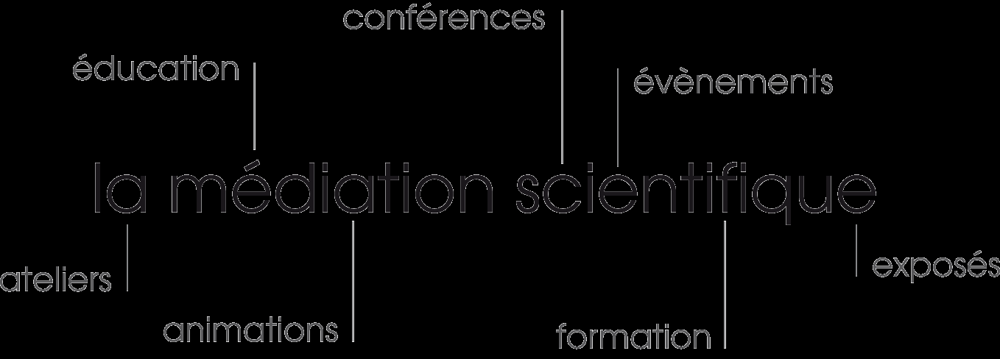

mpx 0.506238
False 1821 278


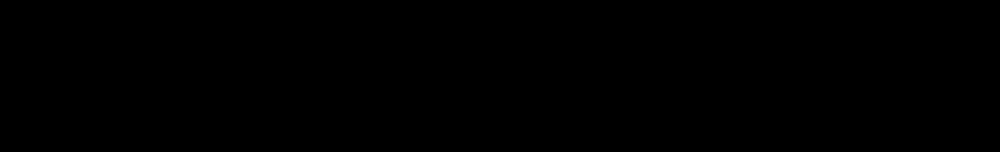

mpx 0.690048
False 1797 384


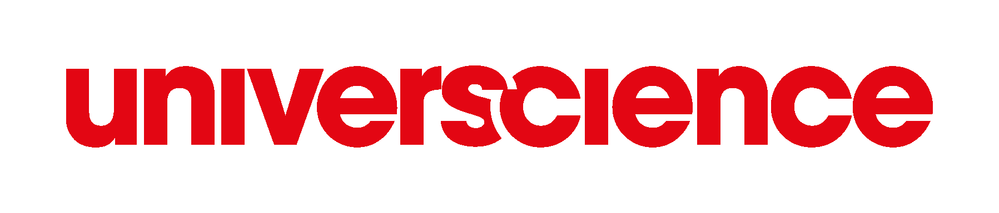

mpx 0.573344
True 874 656


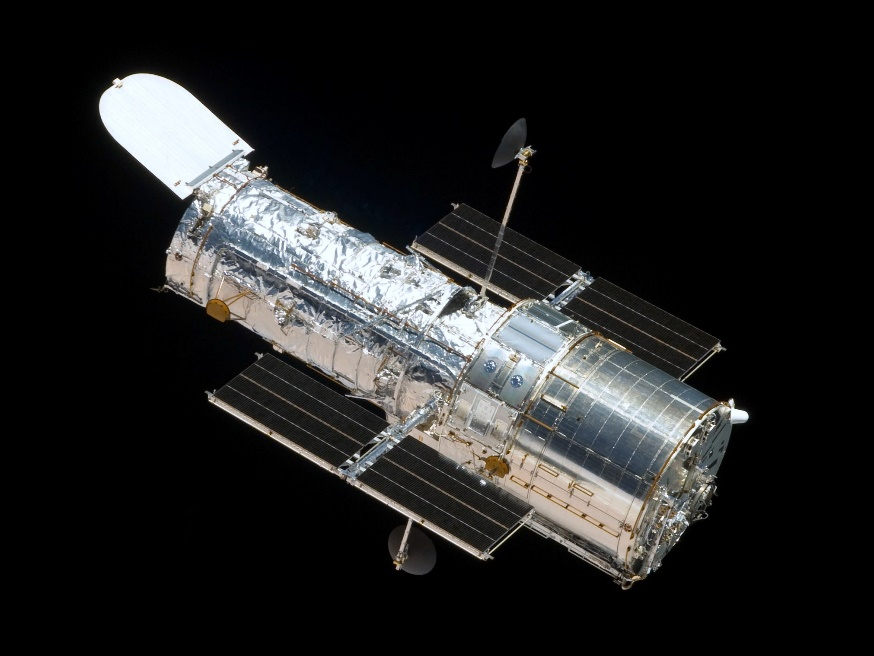

mpx 0.963264
True 696 1384


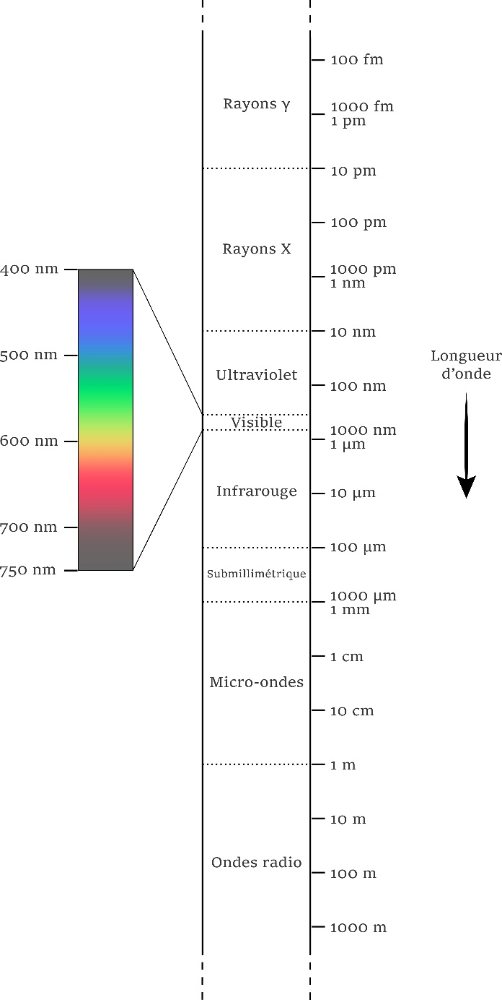

mpx 0.49698
True 753 660


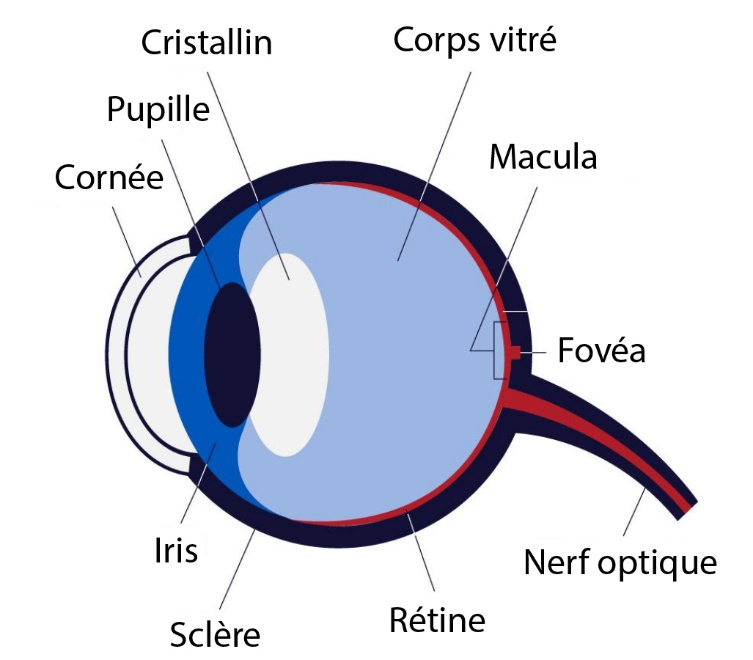

mpx 0.948794
True 1342 707


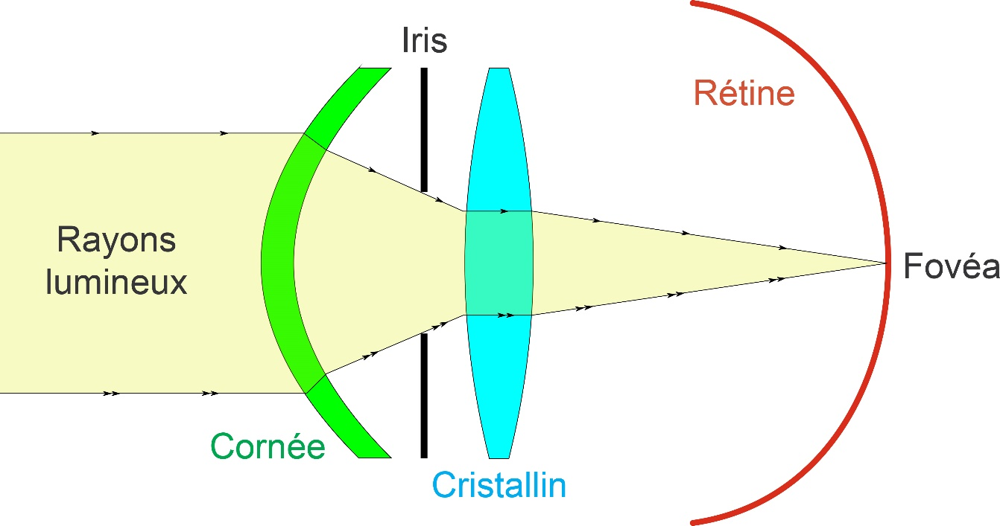

mpx 0.533568
False 1344 397


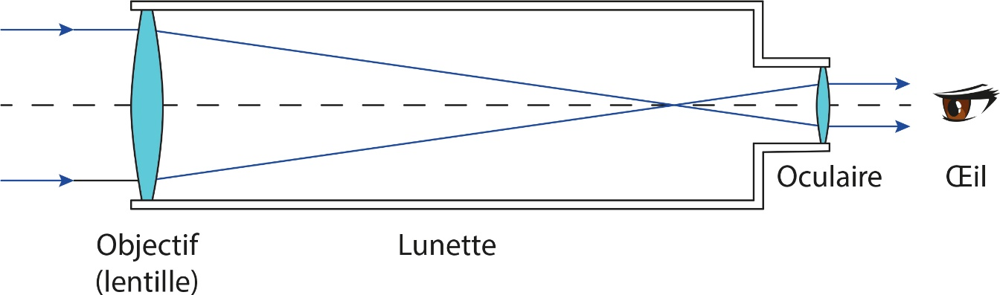

mpx 0.618382
False 1327 466


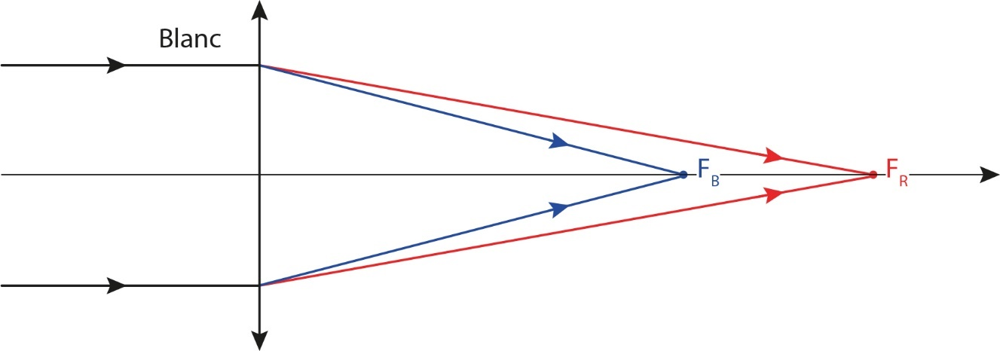

mpx 0.64512
True 1024 630


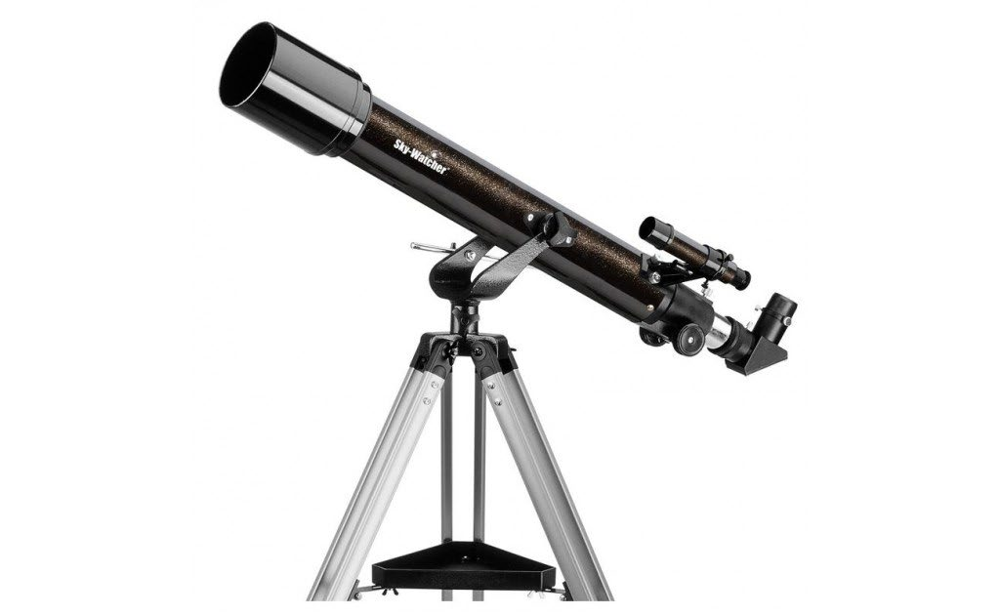

mpx 0.36
True 600 600


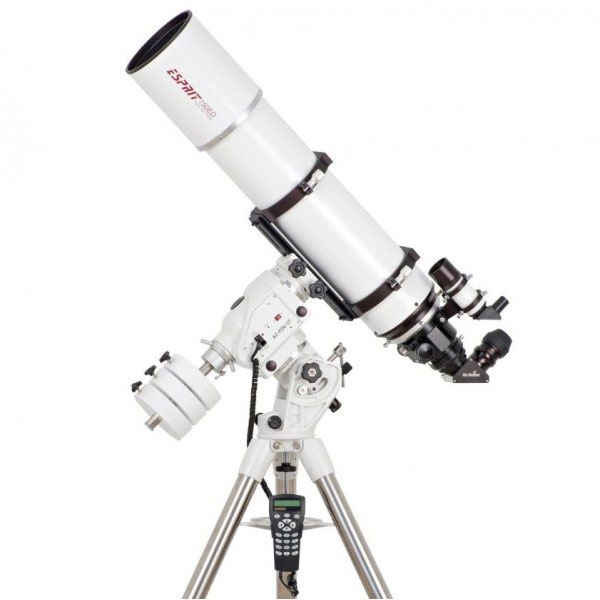

mpx 1.292571
True 1323 977


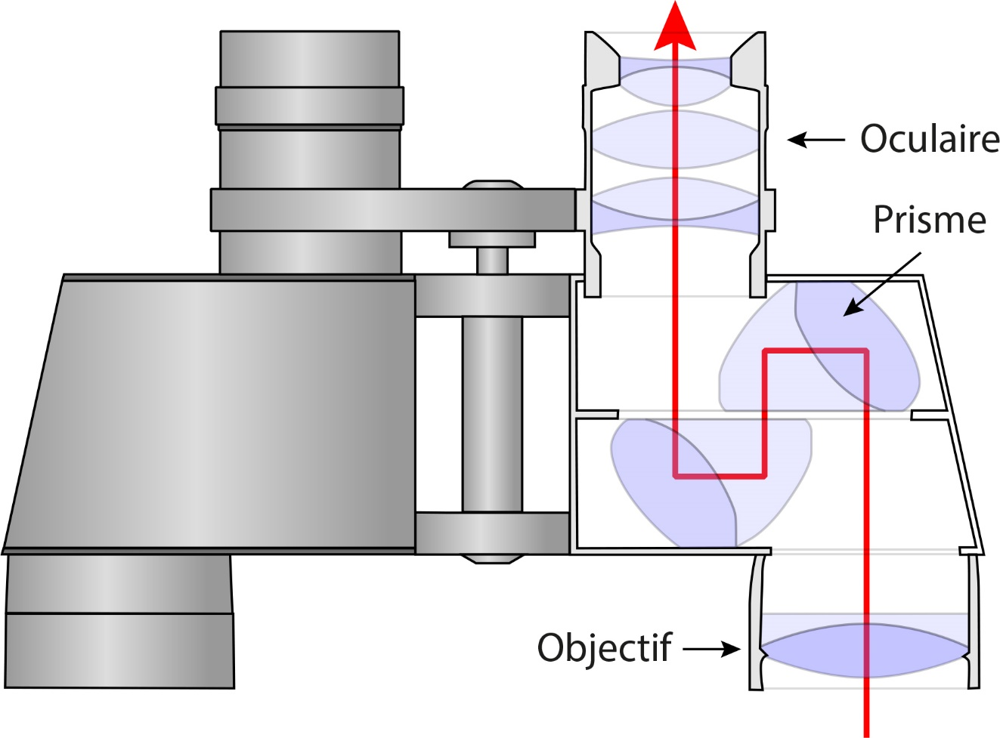

mpx 0.900482
True 1342 671


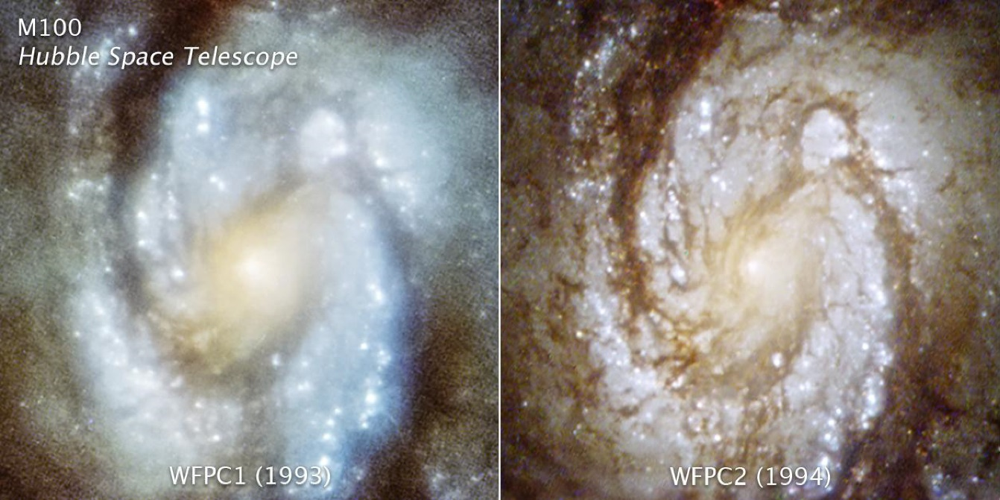

mpx 0.739993
False 1343 551


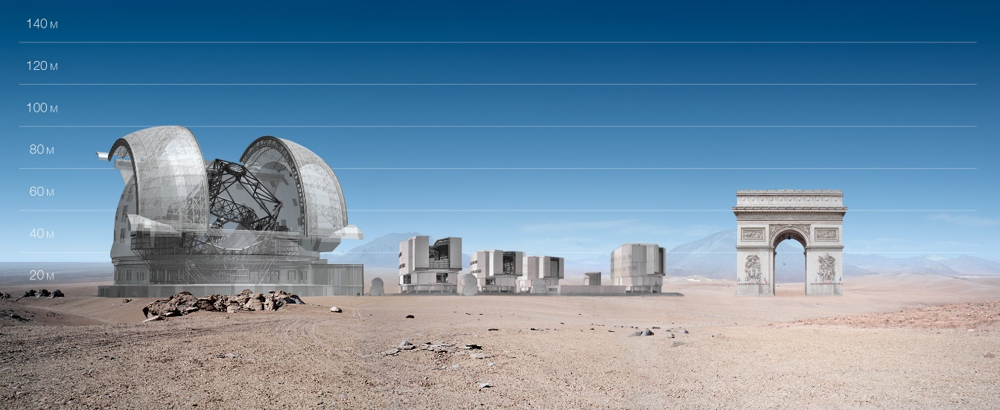

mpx 0.687616
False 1343 512


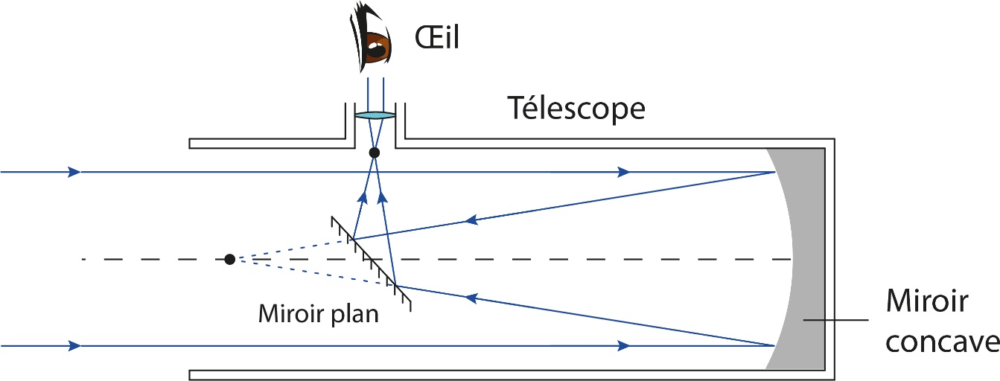

mpx 0.5301
False 1140 465


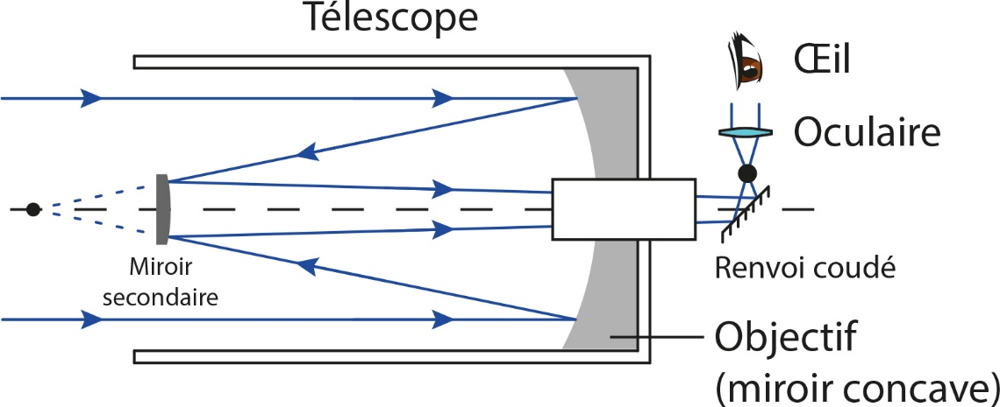

mpx 0.154752
True 312 496


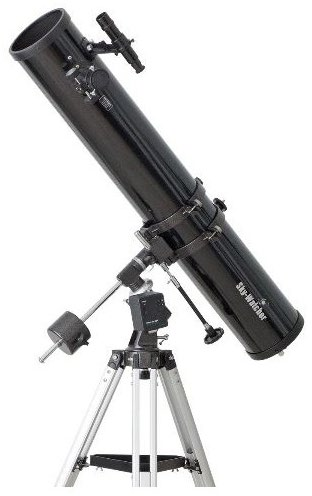

mpx 0.16428
True 296 555


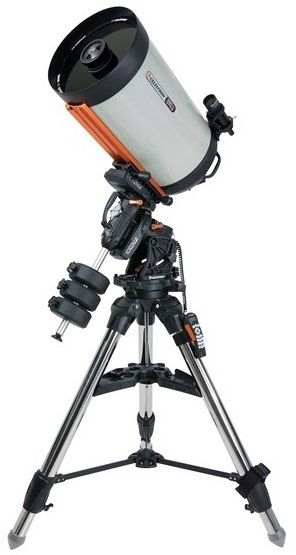

mpx 0.0676
True 260 260


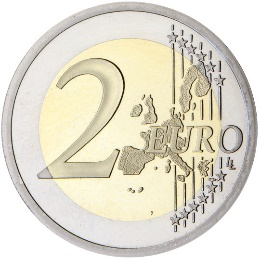

mpx 0.0676
True 260 260


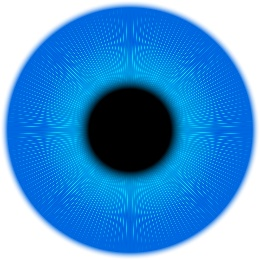

mpx 0.27
False 900 300


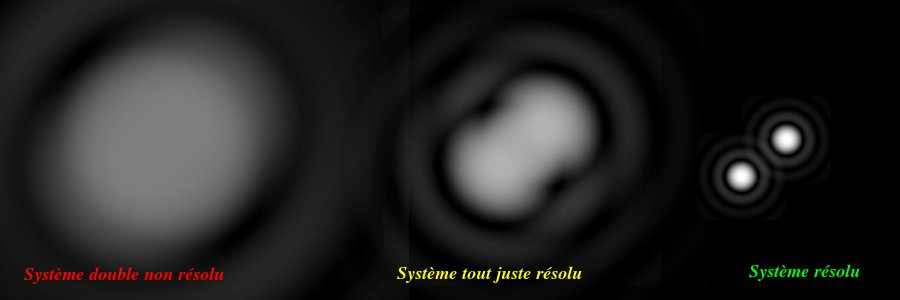

mpx 0.3136
True 560 560


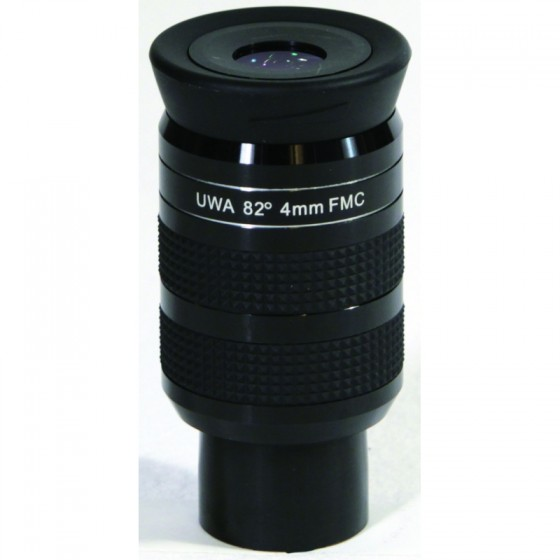

mpx 0.3136
True 560 560


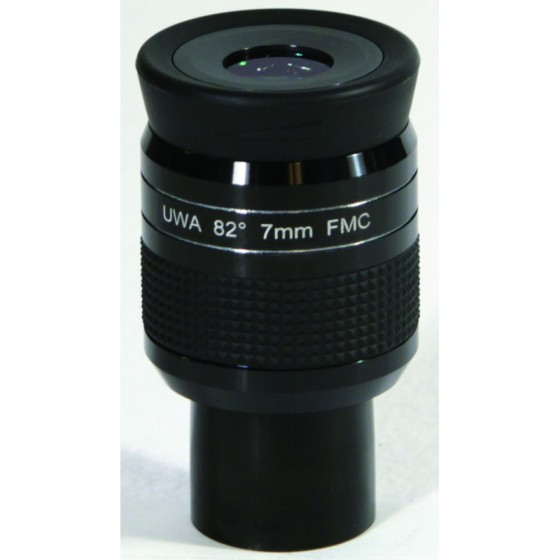

mpx 0.3136
True 560 560


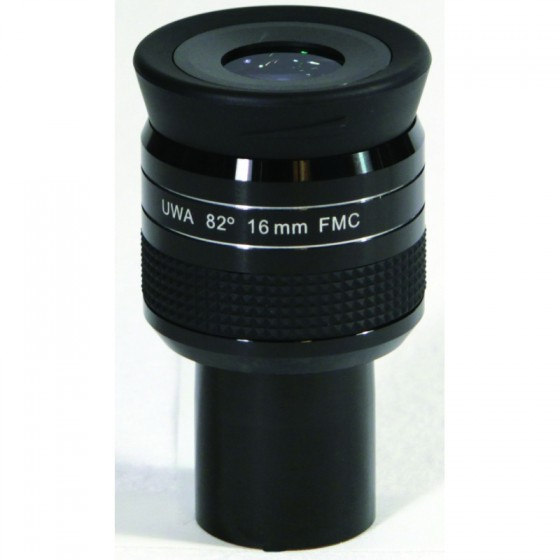

mpx 0.997704
True 1341 744


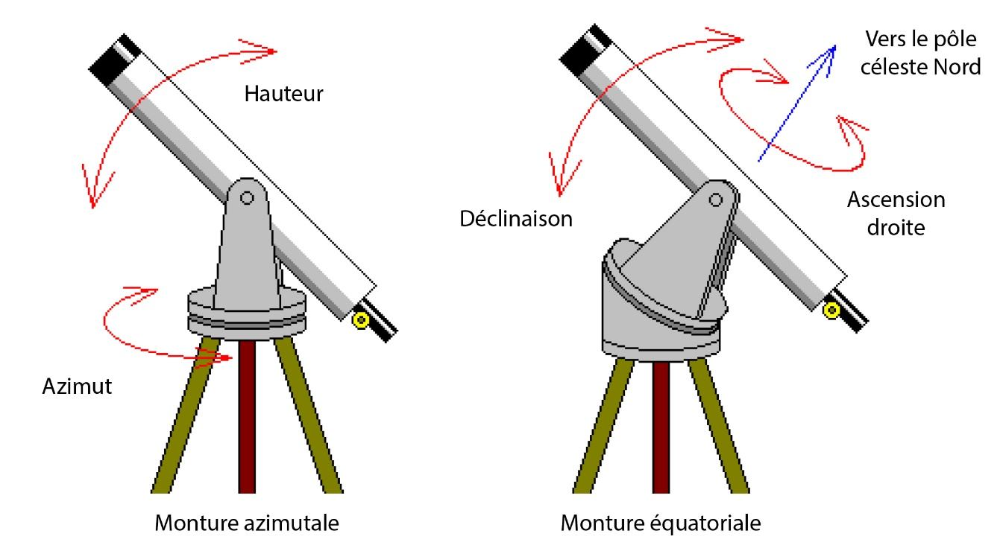

mpx 0.269361
True 519 519


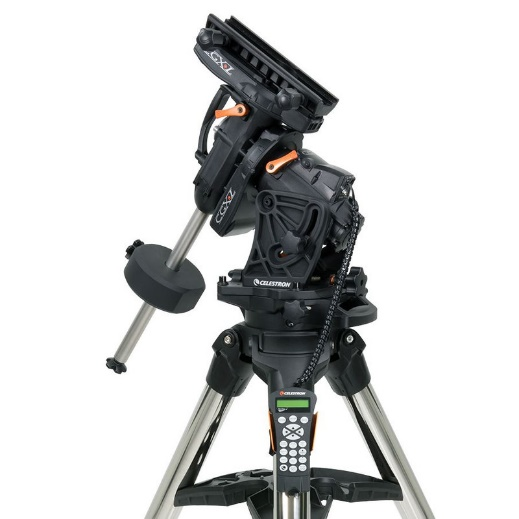

mpx 0.269361
True 519 519


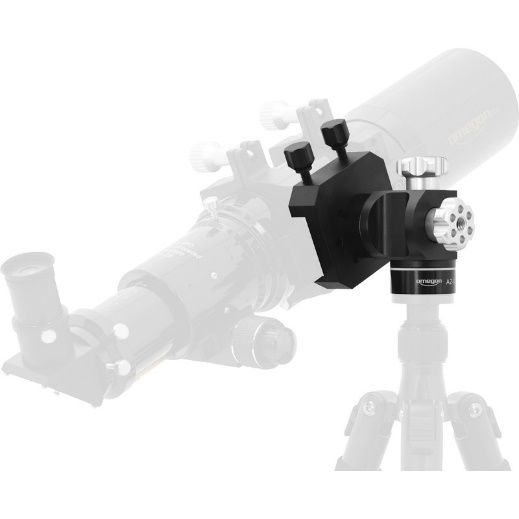

mpx 0.000225
True 15 15


mpx 0.000225
True 15 15


mpx 0.000225
True 15 15


mpx 0.000225
True 15 15


mpx 0.625185
False 1263 495


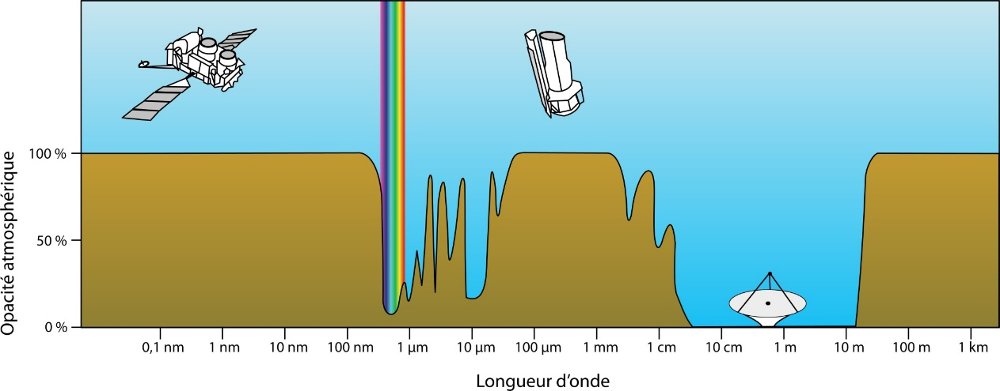

mpx 0.4264
True 800 533


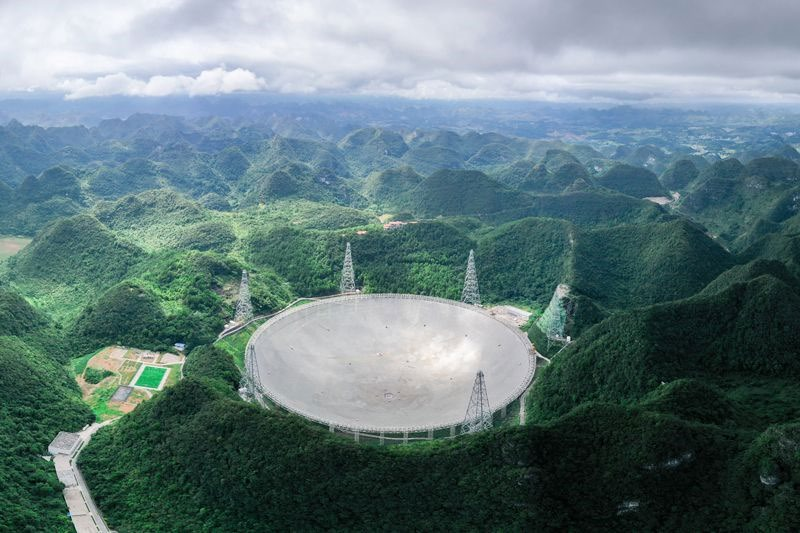

mpx 0.000225
True 15 15


mpx 1.09184
True 1280 853


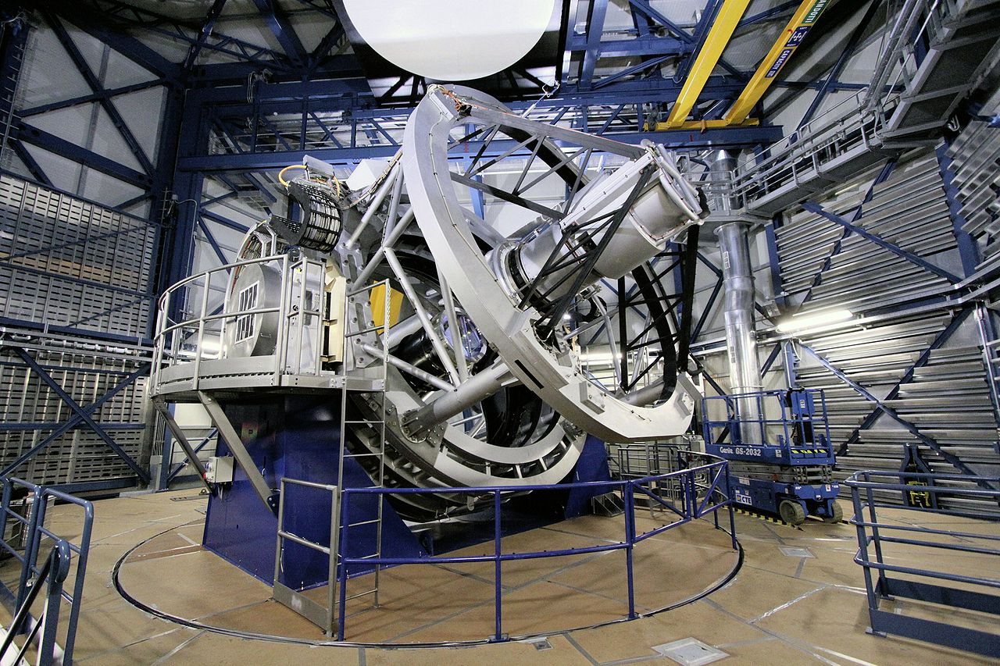

mpx 1.351394
True 1342 1007


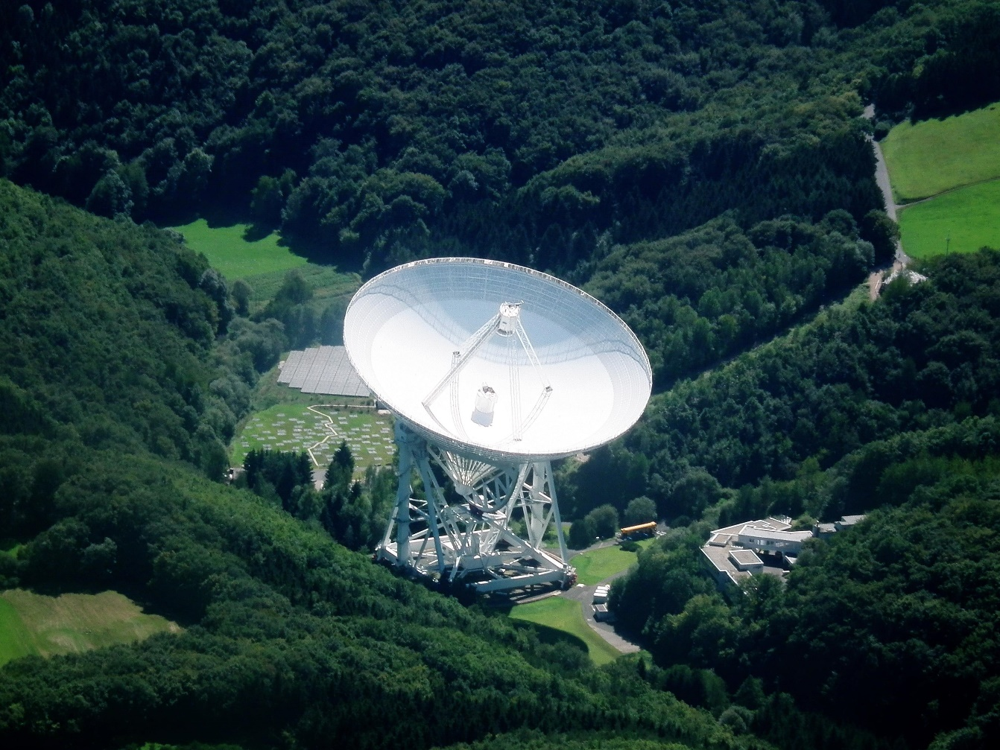

mpx 0.95488
True 1280 746


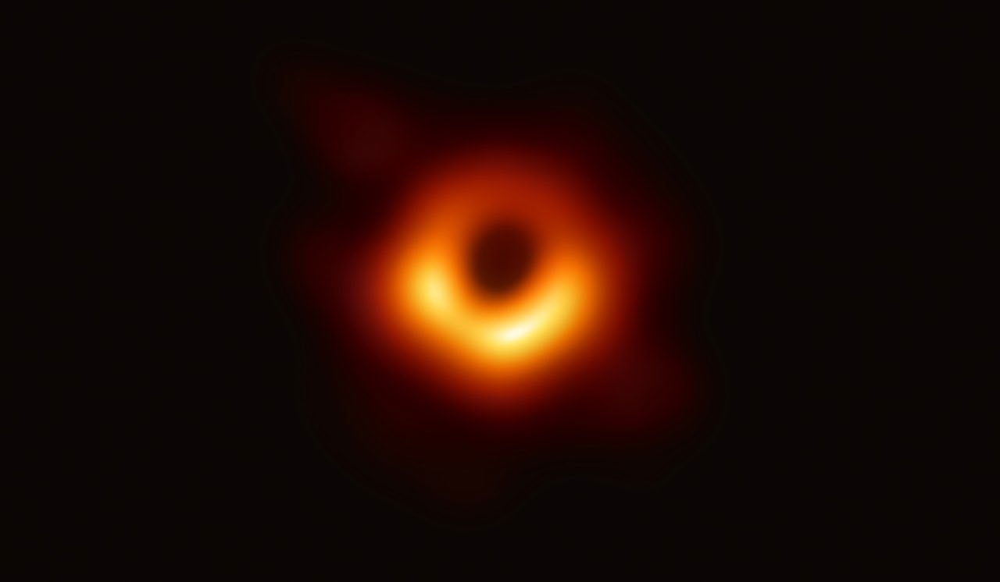

mpx 0.000225
True 15 15


mpx 1.083801
True 1343 807


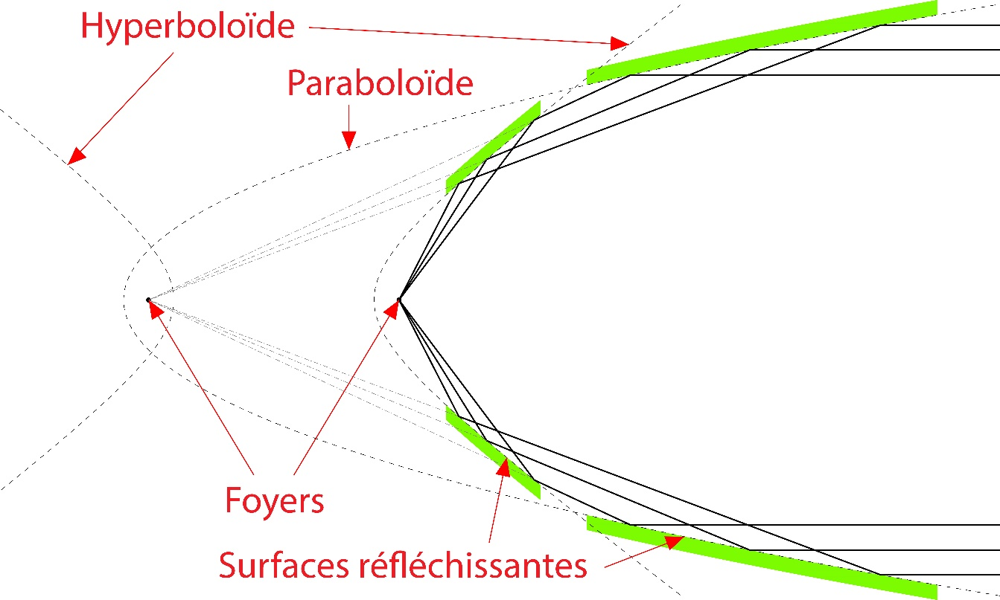

mpx 0.393216
True 768 512


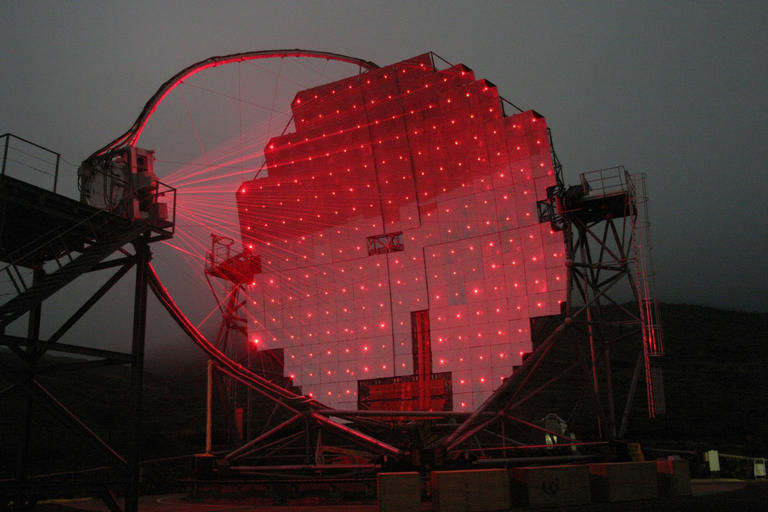

mpx 0.000225
True 15 15


mpx 1.09848
True 1194 920


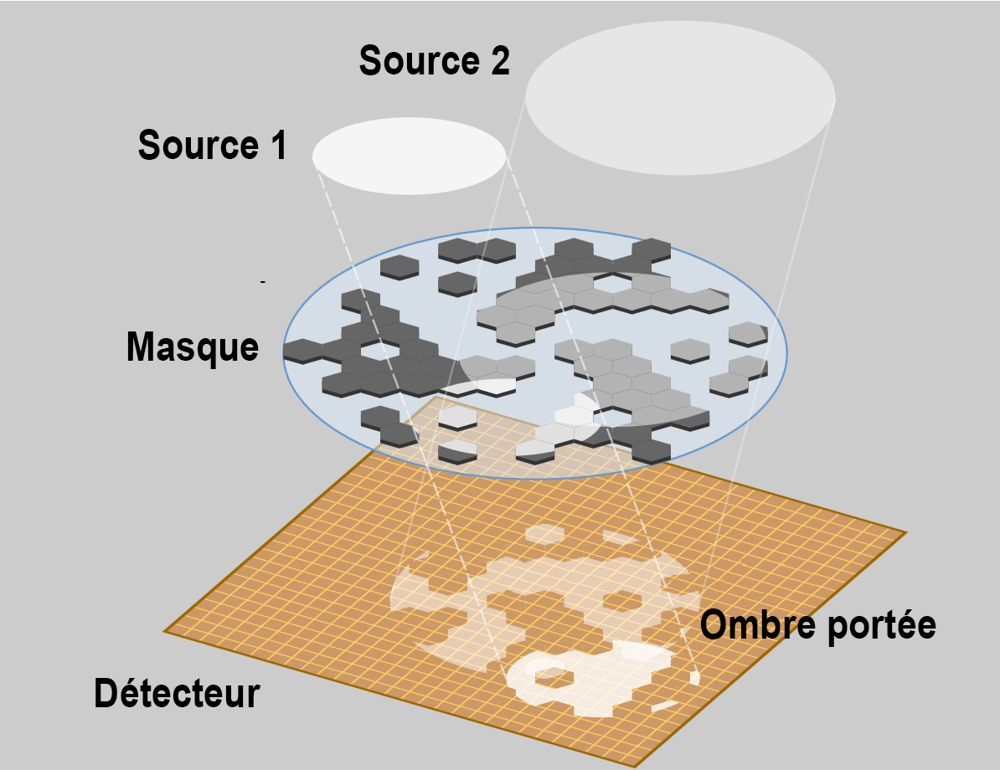

mpx 0.000225
True 15 15


mpx 0.511683
False 1343 381


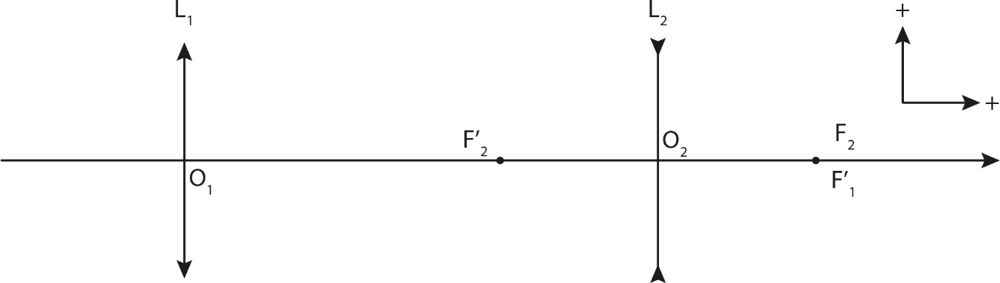

mpx 0.515712
False 1343 384


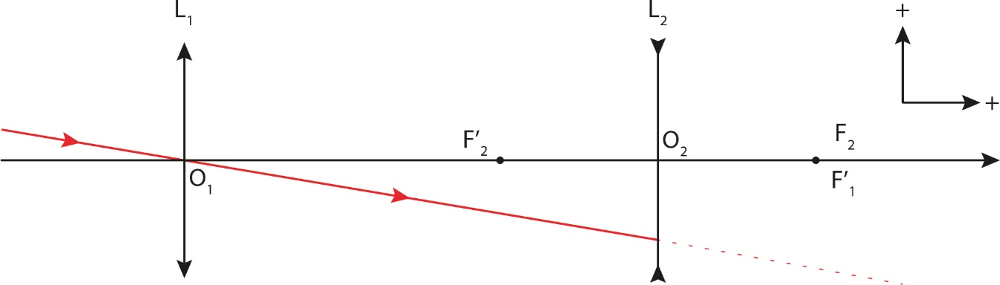

mpx 0.560031
False 1343 417


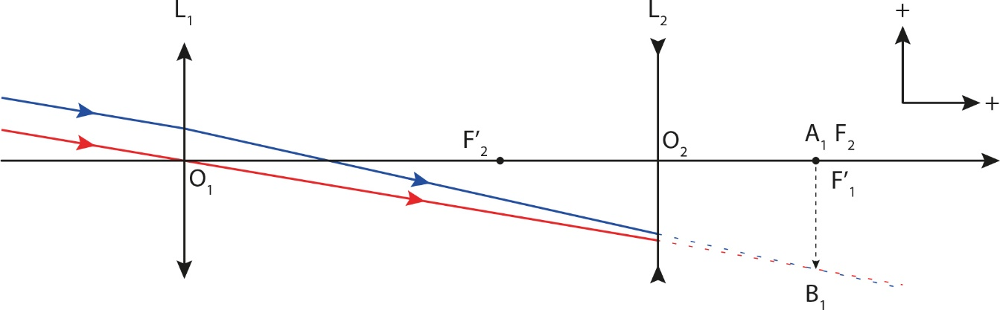

mpx 0.632553
False 1343 471


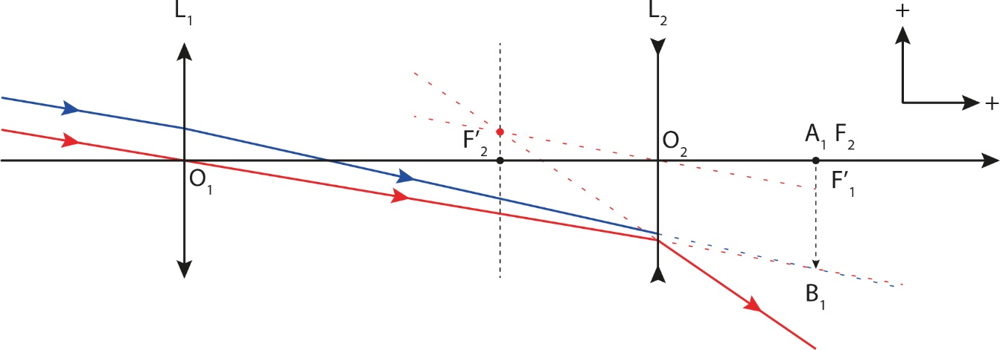

mpx 0.632553
False 1343 471


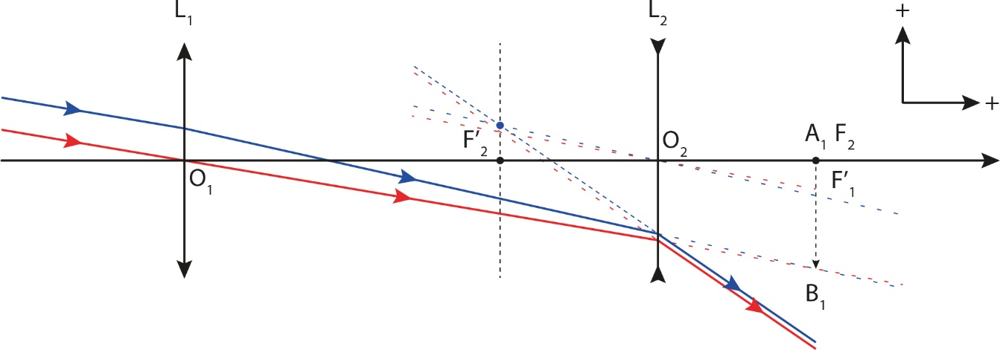

mpx 0.670157
False 1343 499


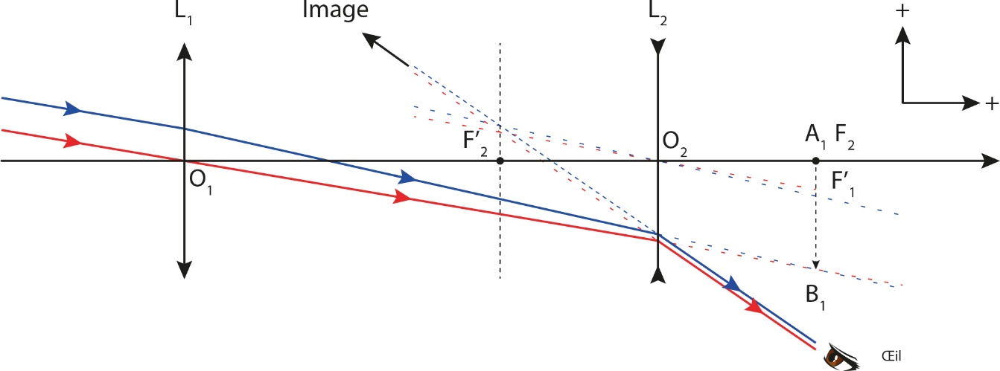

mpx 0.000225
True 15 15


mpx 0.670157
False 1343 499


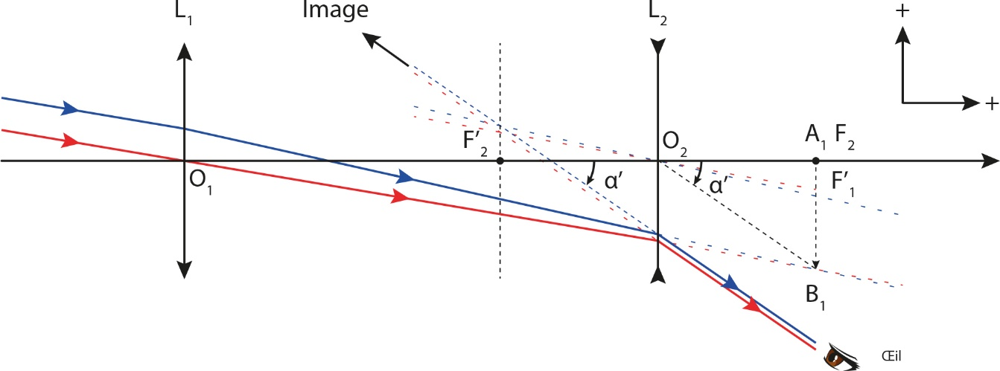

mpx 0.670157
False 1343 499


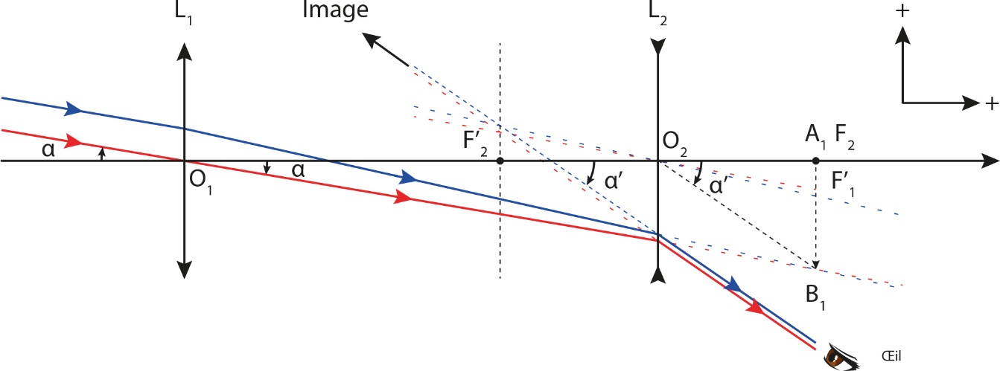

mpx 0.000225
True 15 15


mpx 0.652698
False 1343 486


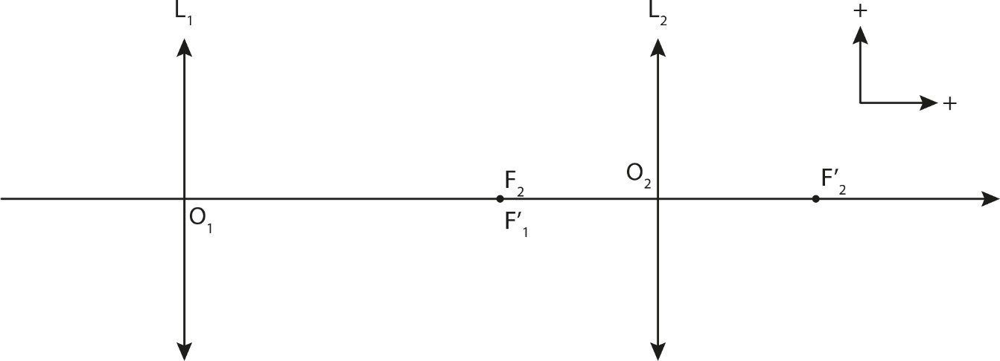

mpx 0.652698
False 1343 486


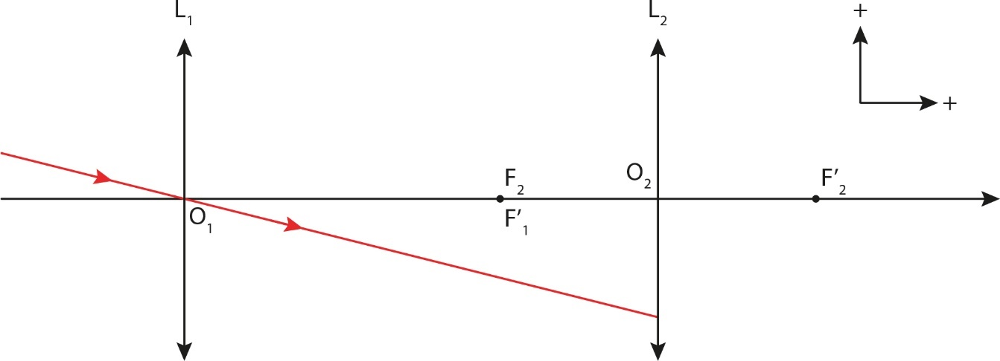

mpx 0.652698
False 1343 486


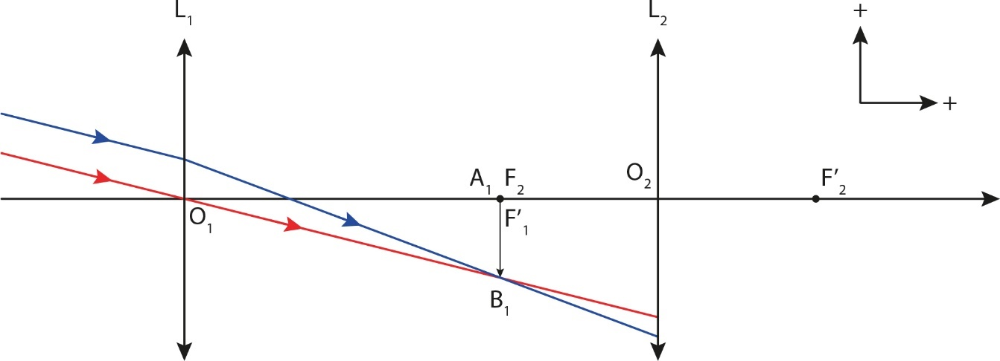

mpx 0.652698
False 1343 486


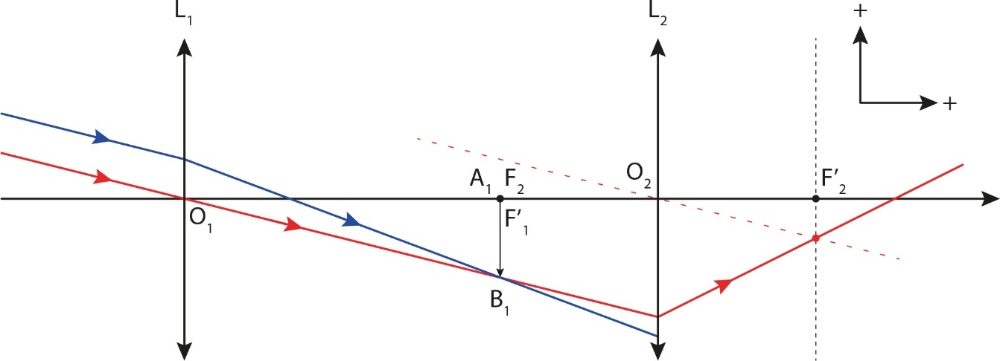

mpx 0.652698
False 1343 486


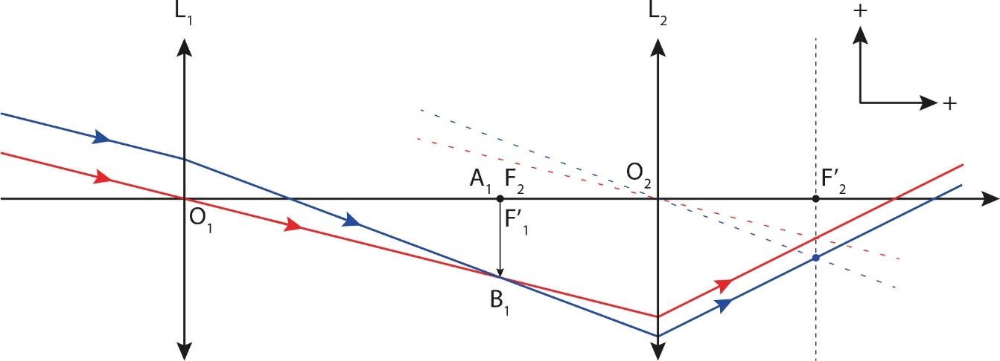

mpx 0.75208
False 1343 560


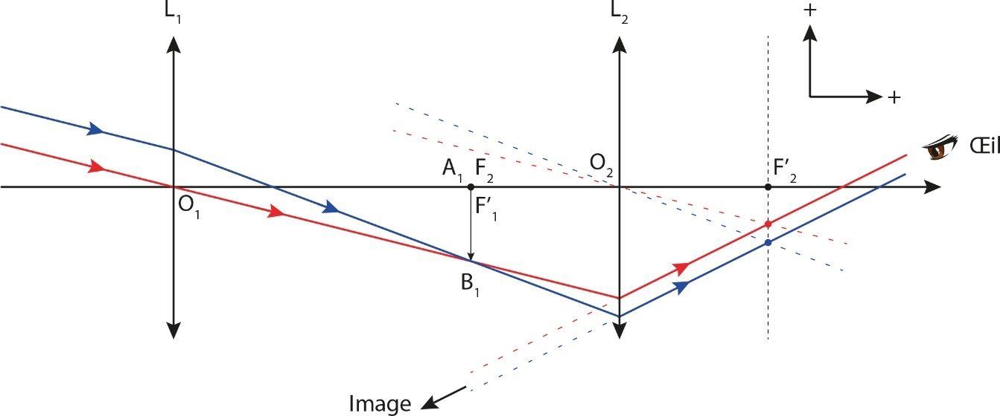

mpx 0.000225
True 15 15


mpx 0.75208
False 1343 560


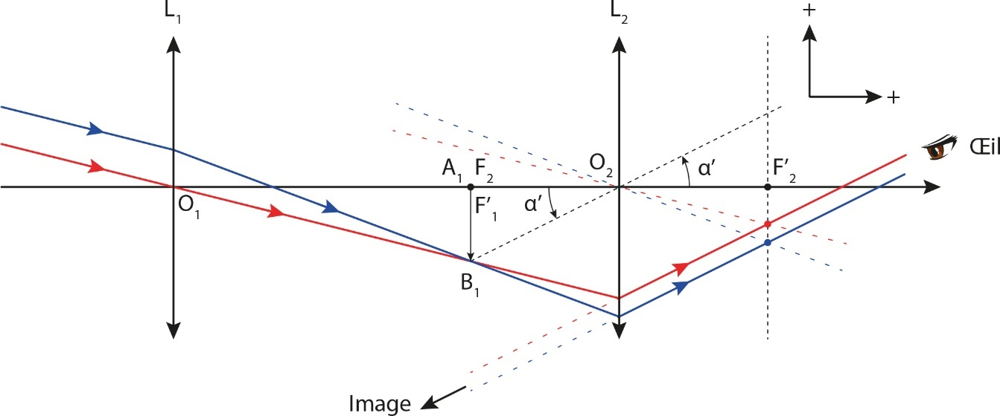

mpx 0.75208
False 1343 560


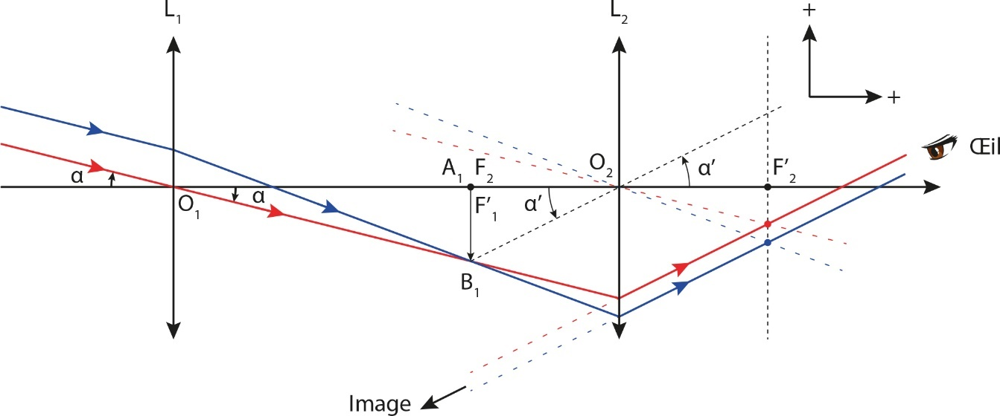

In [22]:
for img_base64, image in chunks[:100]:
    print(keep_image(image.width, image.height), image.width, image.height)
    display(Image(data=base64.b64decode(img_base64), width=400))
    print("=================")

    # caption = image_descriptor.get_description(image)
    # print(caption)
    # translated_caption = translator.en_to_fr(texts=[caption])[0]
    # print(translated_caption)
    # print("\n")

{'<MORE_DETAILED_CAPTION>': 'The image is a black square with white words on it. The words are in French and are arranged in a grid-like pattern. Each word is written in a different language. The first word is "education" and the second is "conférences". The third is "évenements". The fourth is "animations". The fifth is "formation".'}
Time for caption: 0.51 seconds
{'<OCR>': 'conférenceséducationévénementsla médiation scientifiquetateliersexposésanimationsformation'}
Time for OCR: 0.25 seconds


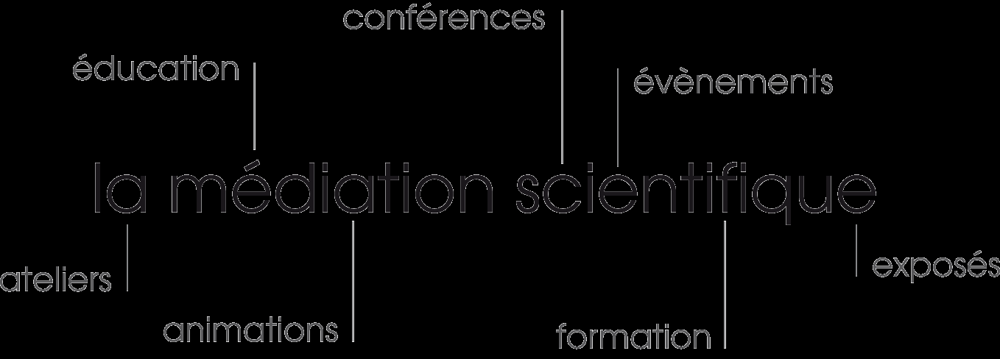

{'<MORE_DETAILED_CAPTION>': 'The image is completely black. The image is very dark. There are no lights in the image. The picture was taken at night. There is no image in the picture.'}
Time for caption: 0.42 seconds
{'<OCR>': '0'}
Time for OCR: 0.15 seconds


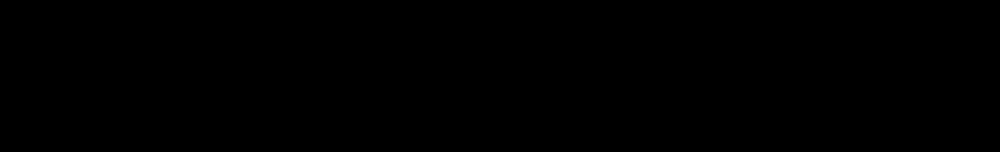

{'<MORE_DETAILED_CAPTION>': 'The word "university" is written in red capital letters. The letters are all the same size and shape. The background of the image is white.'}
Time for caption: 0.27 seconds
{'<OCR>': 'universcience'}
Time for OCR: 0.15 seconds


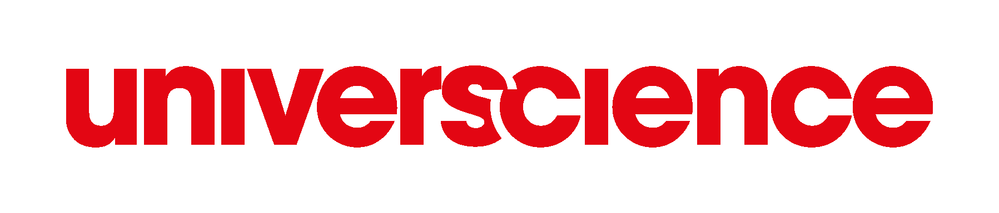

{'<MORE_DETAILED_CAPTION>': 'A satellite is shown in the sky. The satellite is covered in silver foil. There are several solar panels on the side of the satellite. There is a small antenna on top of the structure. '}
Time for caption: 0.31 seconds
{'<OCR>': '-'}
Time for OCR: 0.14 seconds


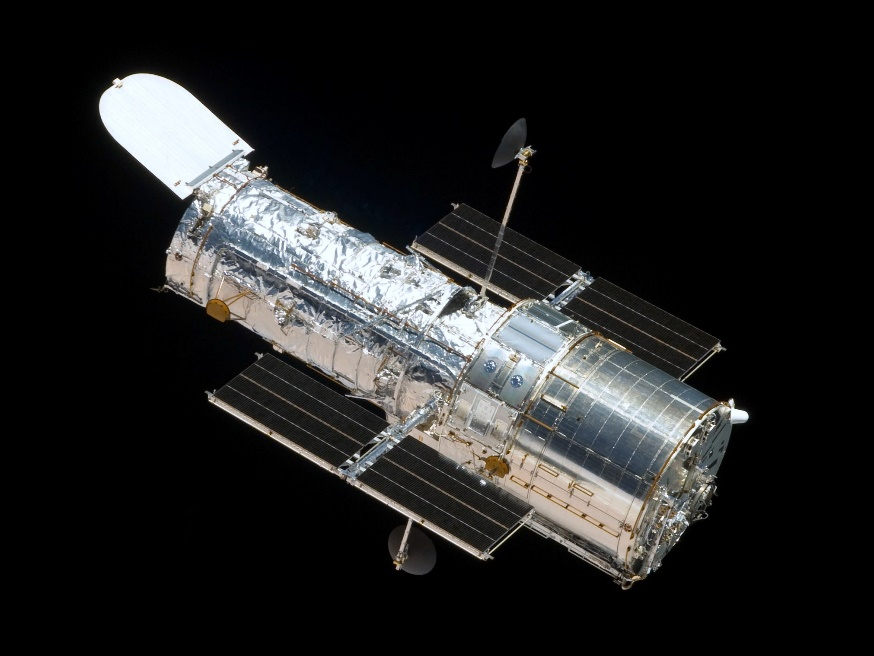

{'<MORE_DETAILED_CAPTION>': 'A diagram shows the relationship between rayons and micro-ondes radio.  The rayons are represented by different colors.  Colors are red, blue, yellow, and orange.  There is an arrow pointing towards the rayons.'}
Time for caption: 0.37 seconds
{'<OCR>': "100 fmRayons y1000 fm1 pm10 pm100 pmRayons X400 nm1000 pm1 mm500 nm10 nmLongueurUltraviolet100 nmd'onde600 nmVisible1000 nm1 umInfrarouge10 um700 nm100 um750 nmSubmillimétrique1000 um1 mm1 cmMicro-ondes10 cm1 m10 mOndes radio100 m1000 m"}
Time for OCR: 0.50 seconds


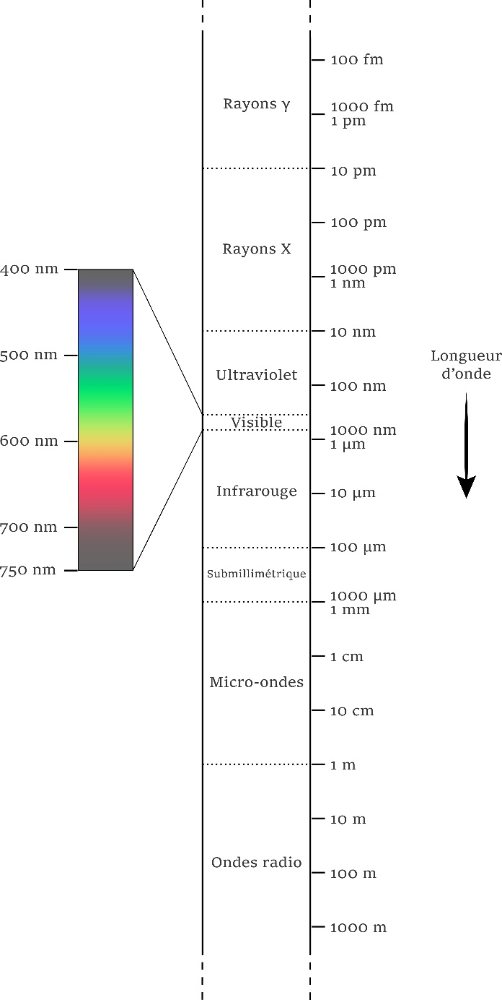

{'<MORE_DETAILED_CAPTION>': 'A diagram of an eye is labeled with the names of the parts of the eye. The eye is colored blue and has a red line going through the middle of it. It also has a white circle in the middle. Around the blue part is labelled with names like cristallin, pupille, cornée, macula, iris, sclère, retine and nerf optique.'}
Time for caption: 0.48 seconds
{'<OCR>': 'CristallinCorps vitréPupilleCornéeMaculaFovéaIrisNerf optiqueSclèreRétine'}
Time for OCR: 0.26 seconds


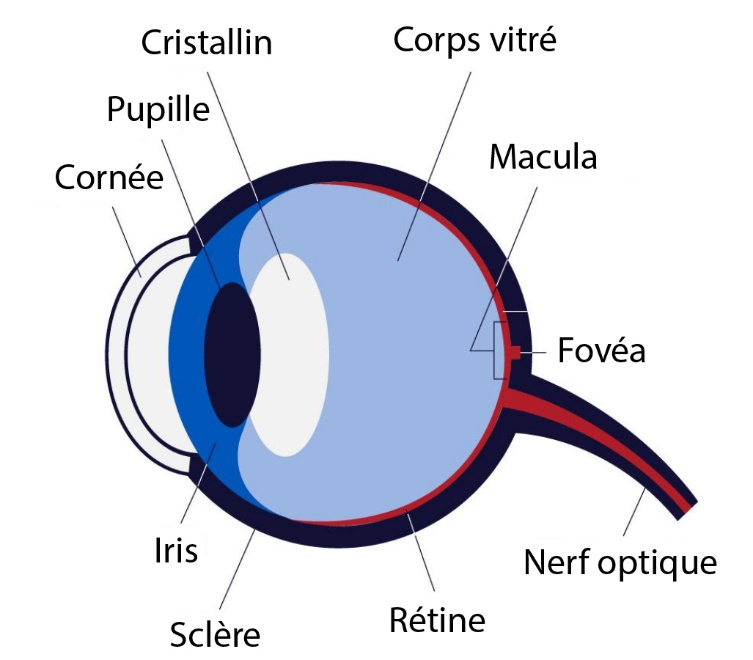

{'<MORE_DETAILED_CAPTION>': 'A diagram is showing the direction of light in a circle. The circle is divided into three sections. On the left side, there is a green section that says "Rayons lumineux" and on the right side, it says "Cornée" and "Cristallin". In the center of the circle is a blue section, and the other three sections are yellow and green. '}
Time for caption: 0.60 seconds
{'<OCR>': 'IrisRétineRayonslumineuxFovéalCornéeCristallin'}
Time for OCR: 0.22 seconds


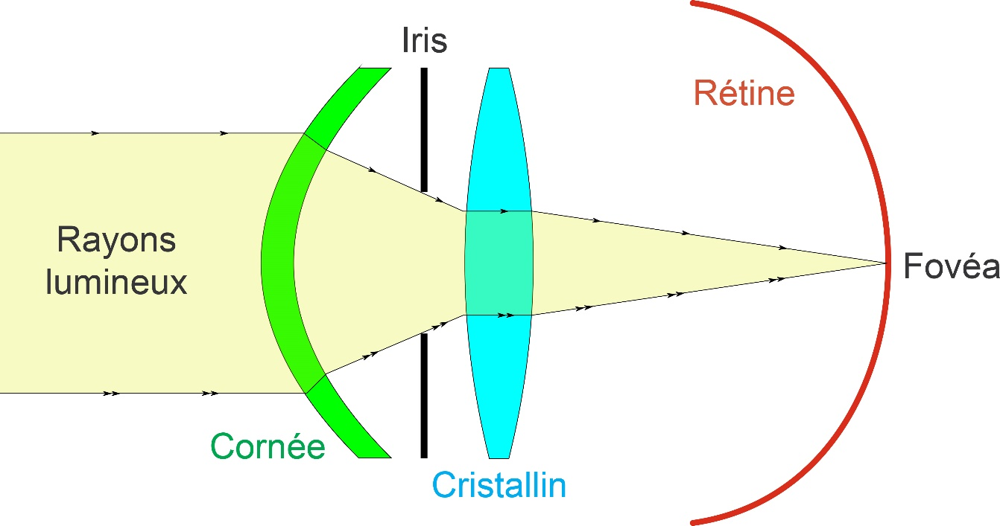

{'<MORE_DETAILED_CAPTION>': 'A diagram is showing the relationship between an eye and an object. The eye is on the right side of the diagram. On the left side, there is an objectif (lentille) written in french. Below the objectif and lunette are written in French.'}
Time for caption: 0.35 seconds
{'<OCR>': 'OculaireEilObjectifLunette(lentille)'}
Time for OCR: 0.20 seconds


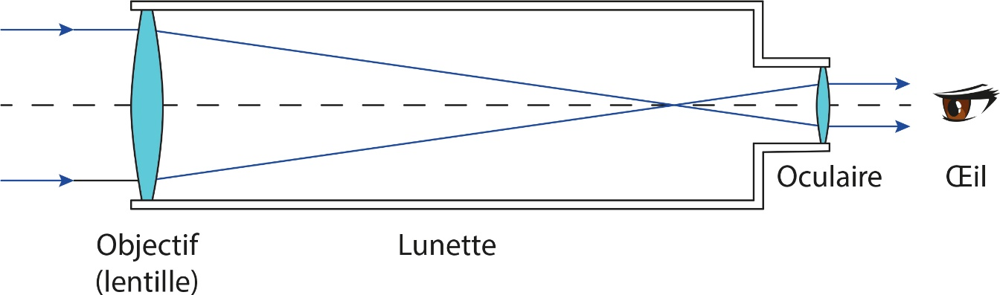

{'<MORE_DETAILED_CAPTION>': 'The image is a diagram that shows the relationship between two lines. On the left side of the image there is the word "Blanc" written on the top left corner. The lines on the right side are red and blue and are going in a straight direction. There are two points on the ends of the lines that intersect at the ends.'}
Time for caption: 0.43 seconds
{'<OCR>': 'BlancFBR'}
Time for OCR: 0.15 seconds


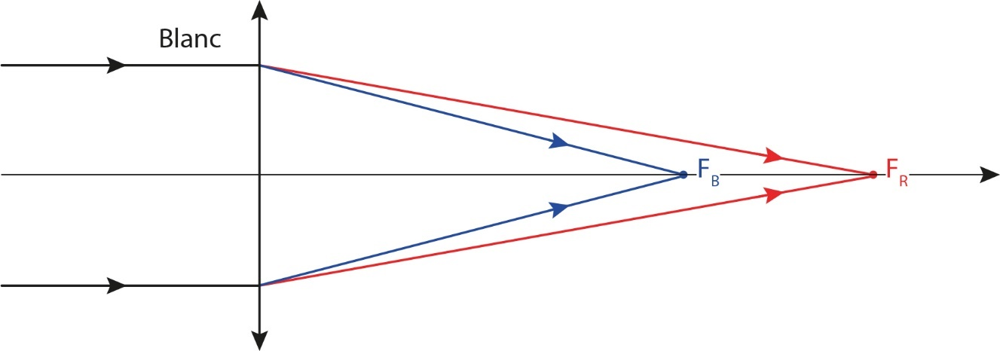

{'<MORE_DETAILED_CAPTION>': 'A telescope is on top of a tripod. The tripod is silver and has a black base. The telescope is black and has white writing on it. '}
Time for caption: 0.28 seconds
{'<OCR>': 'Sky-Watcher'}
Time for OCR: 0.15 seconds


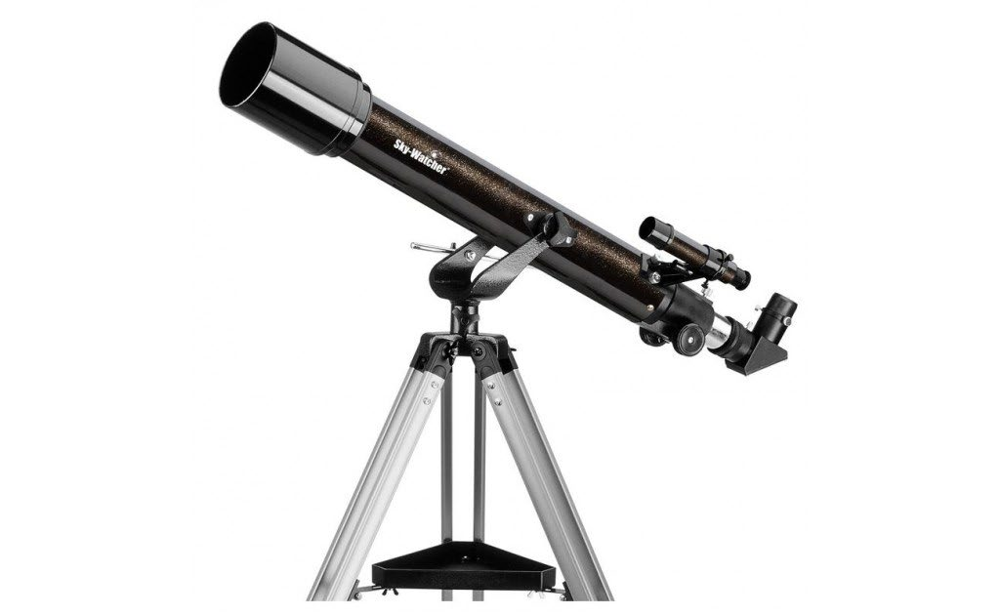

{'<MORE_DETAILED_CAPTION>': 'A telescope is standing on a tripod. The tripod is silver in color. The telescope is white and has a black lens on it. There is writing on the side of the telescope. '}
Time for caption: 0.29 seconds
{'<OCR>': 'ESPAIT ISBRED'}
Time for OCR: 0.16 seconds


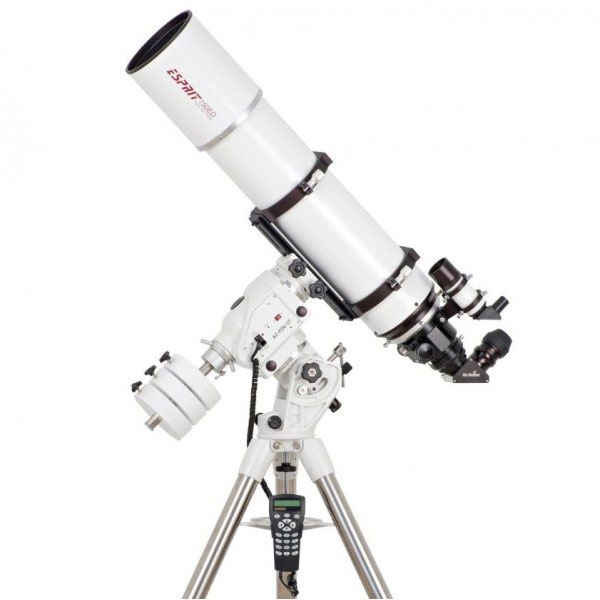

{'<MORE_DETAILED_CAPTION>': 'A diagram of a machine is shown. It is gray in color and has a red arrow pointing towards the center of the machine. The arrow is pointing to the right, which is labeled as "Oculaire" and "Prisme". There is a red line going through the center, towards the right. Below the red line, there is the word "Objectif" written in black.'}
Time for caption: 0.48 seconds
{'<OCR>': 'OculairePrismeObjectif'}
Time for OCR: 0.17 seconds


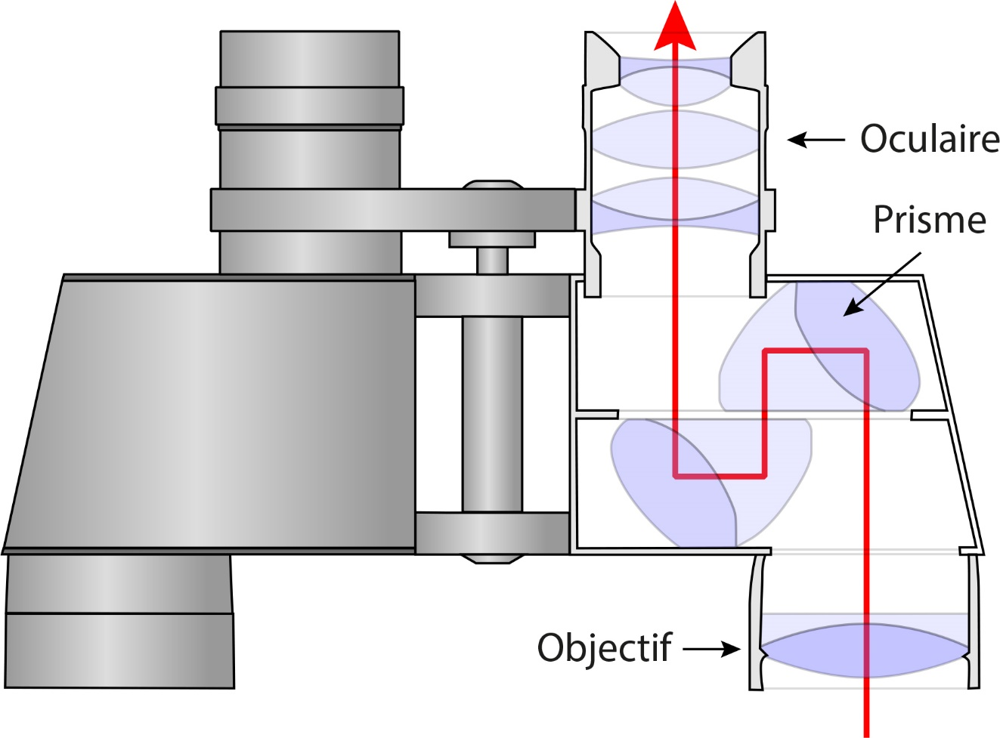

{'<MORE_DETAILED_CAPTION>': 'A picture of a galaxy is labeled as M100 Hubble Space telescope. The picture on the left is labeled WFPC1 (1993) and shows a spiral galaxy with a yellow center. The photo on the right is labeled wFPC2 (1994) as well.'}
Time for caption: 0.41 seconds
{'<OCR>': 'M100Hubble Space TelescopeWFPC1 (1993)WFPc2 (1994)'}
Time for OCR: 0.21 seconds


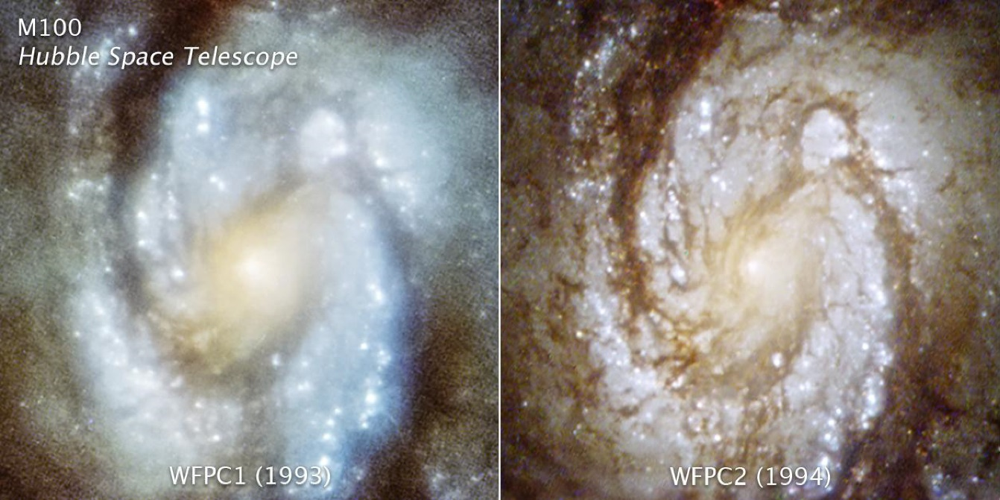

{'<MORE_DETAILED_CAPTION>': 'This is an image of a desert. The sky is very clear and blue. There are no clouds in the sky. The ground is sandy and light brown. There is an archway in the middle of the desert.'}
Time for caption: 0.44 seconds
{'<OCR>': '140 M120 M100 M80 M60 M40 M20 M'}
Time for OCR: 0.18 seconds


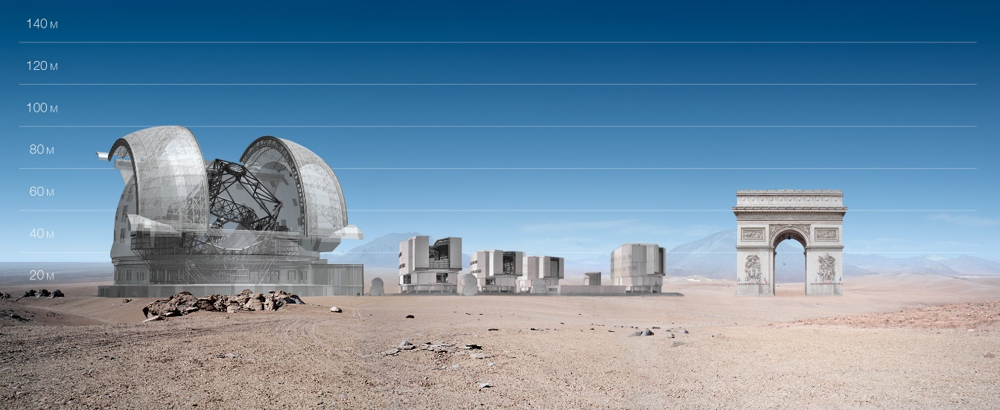

{'<MORE_DETAILED_CAPTION>': 'A diagram shows the relationship between a telescope and a mirror. The diagram also shows the direction of the telescope from the ceiling to the ground.'}
Time for caption: 0.25 seconds
{'<OCR>': 'CeilTélescopeMiroirMiroir planMiroirsconcave'}
Time for OCR: 0.22 seconds


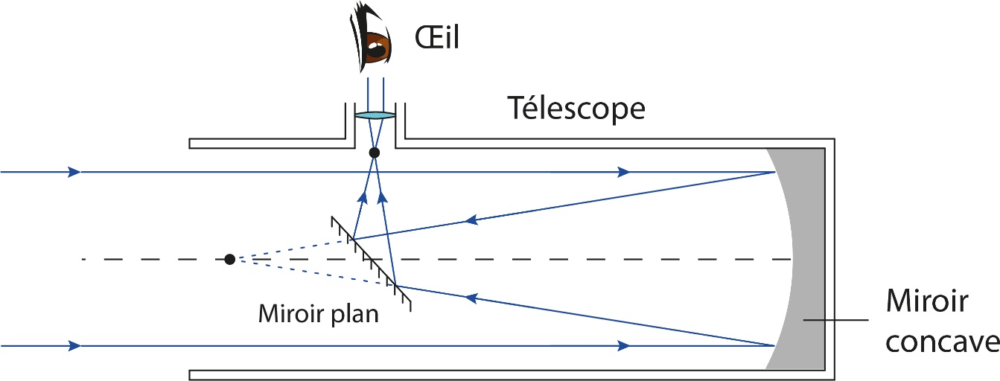

{'<MORE_DETAILED_CAPTION>': 'A diagram of a telescope is shown. It shows the direction of the telescope from the left to the right. There are several blue arrows pointing towards the telescope. On the right, there is a diagram of an eye with the word "Oculaire" written above it.'}
Time for caption: 0.37 seconds
{'<OCR>': 'TélescopeCEilOculaireMiroirRenvoi coudésecondaireObjectif(miroir concave)'}
Time for OCR: 0.25 seconds


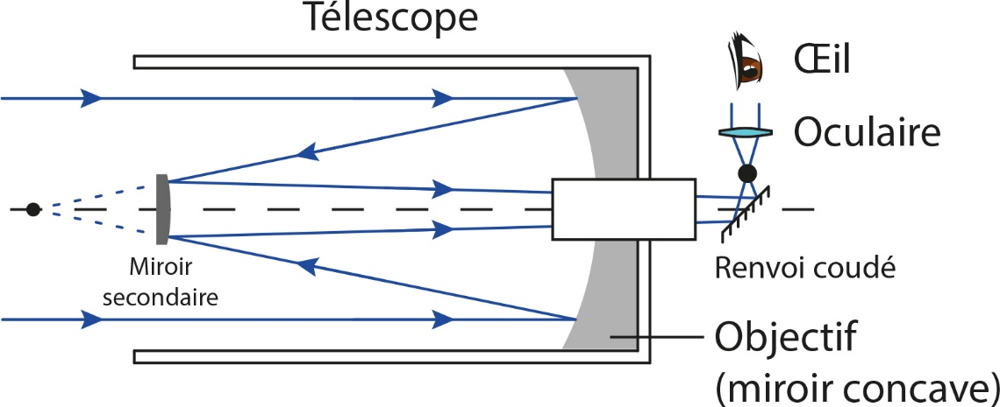

{'<MORE_DETAILED_CAPTION>': 'A large telescope is sitting on top of a tripod. The tripod is silver and has four legs. The telescope is black in color and has a long tube at the top. There is a black handle on the top of the telescope.'}
Time for caption: 0.32 seconds
{'<OCR>': 'Sky-Watcher'}
Time for OCR: 0.16 seconds


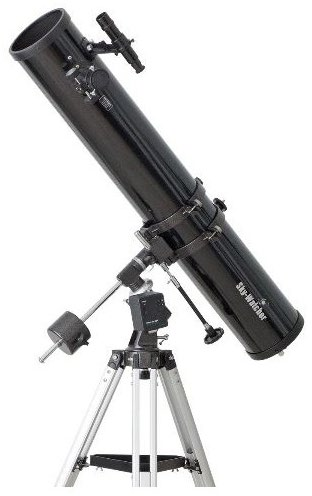

{'<MORE_DETAILED_CAPTION>': 'A large telescope is on top of a tripod. The tripod is silver and black. The telescope is white and orange. There is a black lens on the top of the telescope. '}
Time for caption: 0.28 seconds
{'<OCR>': 'CELESTRON'}
Time for OCR: 0.16 seconds


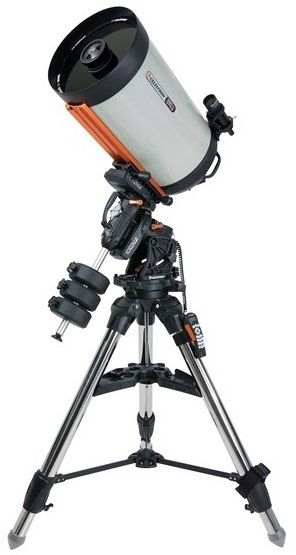

{'<MORE_DETAILED_CAPTION>': 'A silver and gold coin with the number 2 on it. There are stars on the side of the coin. There is a map on the coin with a yellow background. '}
Time for caption: 0.29 seconds
{'<OCR>': 'EURO'}
Time for OCR: 0.14 seconds


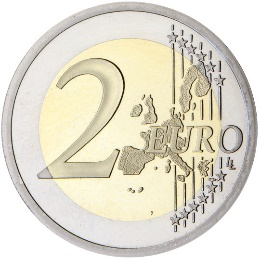

{'<MORE_DETAILED_CAPTION>': 'A blue circle has a black hole in the middle of it. There are lines on the blue circle. The background is white.'}
Time for caption: 0.24 seconds
{'<OCR>': 'O'}
Time for OCR: 0.13 seconds


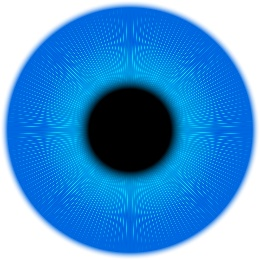

{'<MORE_DETAILED_CAPTION>': 'A black and white image is displayed on a black background. There are three white circles on the right side of the image. On the bottom left and right of the images there is yellow text that says "Systeme double non resolu" and "Système tout juste résolu".'}
Time for caption: 0.39 seconds
{'<OCR>': 'Système double non résoluSysteme tout juste résoluSystéme resolu'}
Time for OCR: 0.25 seconds


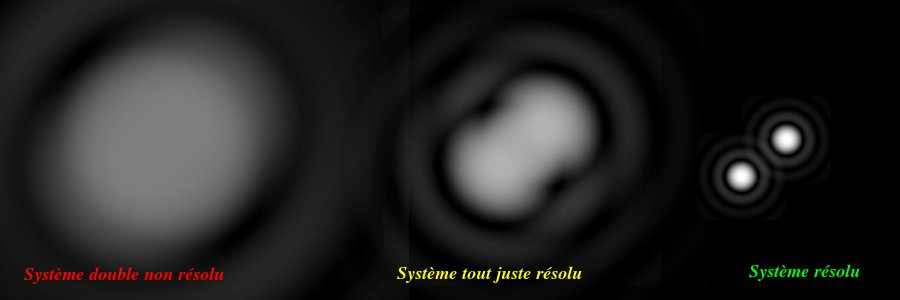

{'<MORE_DETAILED_CAPTION>': 'This is a zoomed in picture of a camera lens. The lens is black and has white text on it. The text reads "UWA 82" 4mm FMC". The lens appears to be new and unused. The background of the image is white.'}
Time for caption: 0.35 seconds
{'<OCR>': 'UWA 82º 4mm FMC'}
Time for OCR: 0.17 seconds


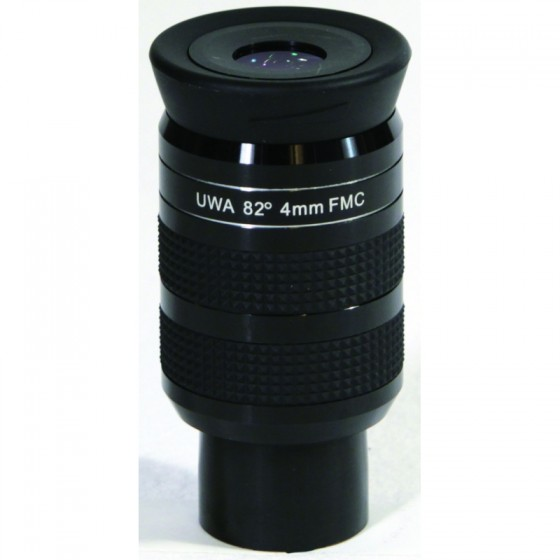

{'<MORE_DETAILED_CAPTION>': 'This is a zoomed in picture of a camera lens. The lens is black and has white text on it. The text reads "UWA 82" 7mm FMC". The lens appears to be new and in good condition.'}
Time for caption: 0.34 seconds
{'<OCR>': 'UWA 82º 7mm FMC'}
Time for OCR: 0.16 seconds


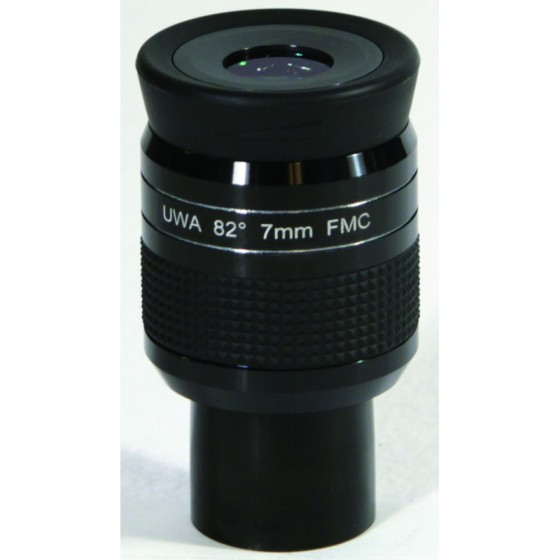

{'<MORE_DETAILED_CAPTION>': 'This is a zoomed in picture of a camera lens. The lens is black and has white text on it. The text reads "UWA 82º 16mm FMC". The lens appears to be new and in good condition. The background is white.'}
Time for caption: 0.34 seconds
{'<OCR>': 'UWA 82º 16mm FMC'}
Time for OCR: 0.16 seconds


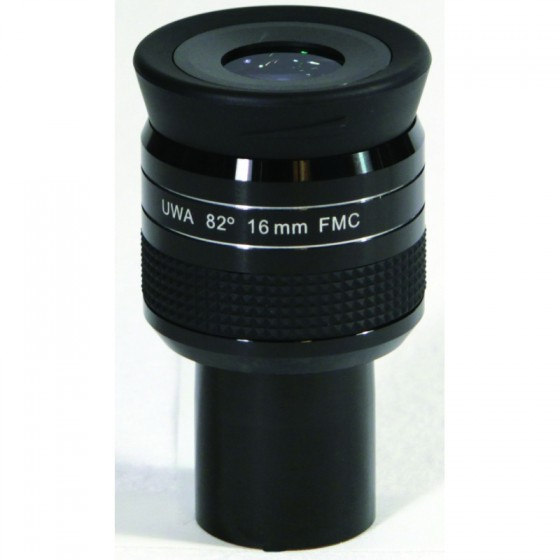

{'<MORE_DETAILED_CAPTION>': 'A diagram of a telescope is shown. It shows the different angles of the telescope and how it works. '}
Time for caption: 0.26 seconds
{'<OCR>': 'Vers le polecéleste NordHauteurDéclinaisonAscensiondroiteAzimutMonture azimutaleMonture équatoriale'}
Time for OCR: 0.30 seconds


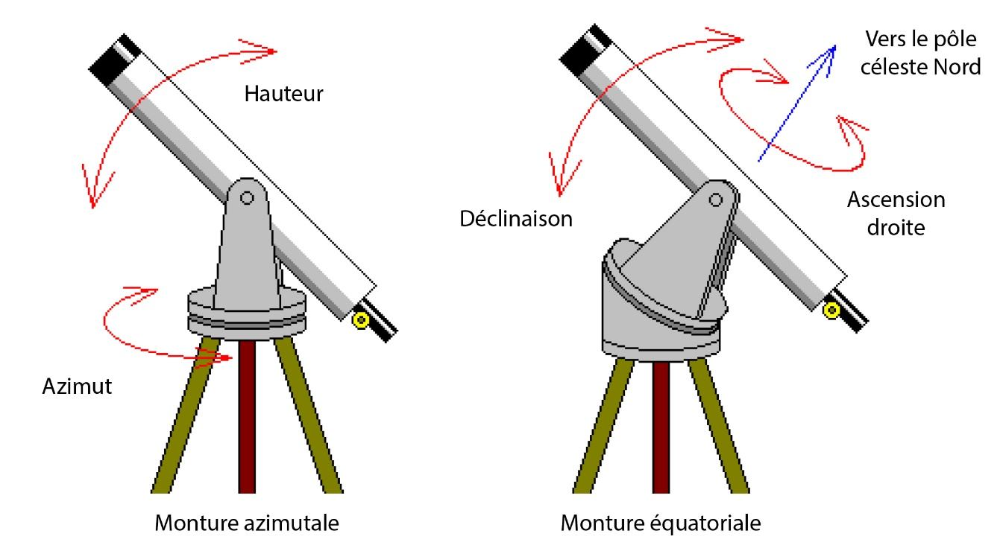

{'<MORE_DETAILED_CAPTION>': 'This is a picture of a telescope. The telescope is black and silver. The tripod is made of metal. The background is white. There is a remote control on the tripod. The remote control has white and green buttons on it. '}
Time for caption: 0.32 seconds
{'<OCR>': 'CELESTRON'}
Time for OCR: 0.15 seconds


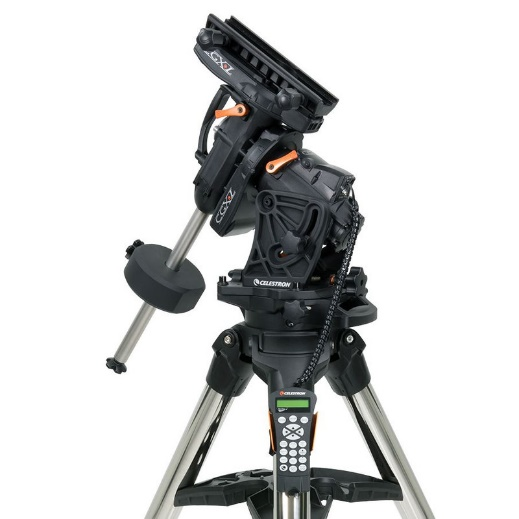

{'<MORE_DETAILED_CAPTION>': 'A black and white image of a telescope on a tripod. The tripod is made of metal and has four legs. The telescope is large and has a long lens. There are two knobs on the top of the telescope for adjusting the angle.'}
Time for caption: 0.43 seconds
{'<OCR>': 'omegon'}
Time for OCR: 0.14 seconds


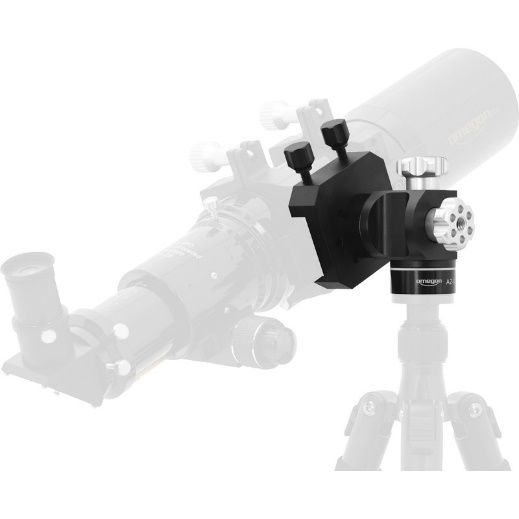

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.43 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.44 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.43 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.43 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'A diagram of a space station is shown. There are three graphs shown. The first graph shows a satellite and the second graph shows an object flying in the sky. The third graph has a rainbow colored line going up and down. The fourth graph has three peaks. The peaks are brown and the peaks are light brown. The sky is blue and there are no clouds.'}
Time for caption: 0.45 seconds
{'<OCR>': "100%50 %0%Opacité atmosphérique0,1 mm1 mm10 mm100 mm1 um10 um100 um 1 mm1 cm10 cm1 m10 m100 m1 kmLongueur d'onde"}
Time for OCR: 0.35 seconds


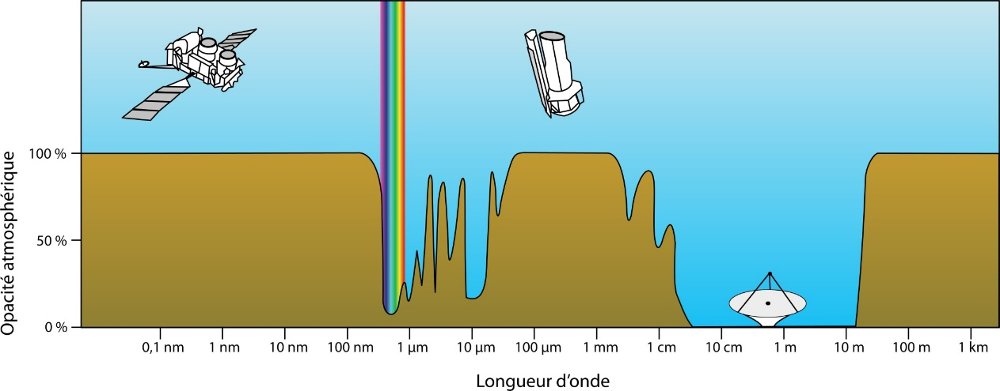

{'<MORE_DETAILED_CAPTION>': 'This is an aerial view of a mountain. The mountain is covered in green trees. There is a large circular structure in the middle of the mountain. There are tall towers on top of the structure. '}
Time for caption: 0.30 seconds
{'<OCR>': 'C'}
Time for OCR: 0.14 seconds


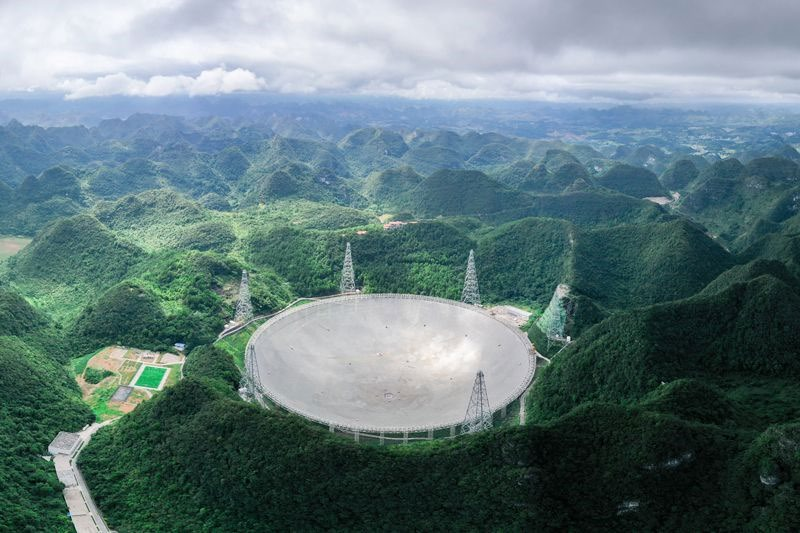

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.43 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'A large telescope is inside of a building. There are blue rails surrounding the telescope. There is a large white satellite hanging from the ceiling. '}
Time for caption: 0.26 seconds
{'<OCR>': 'Gent. GS-3082'}
Time for OCR: 0.17 seconds


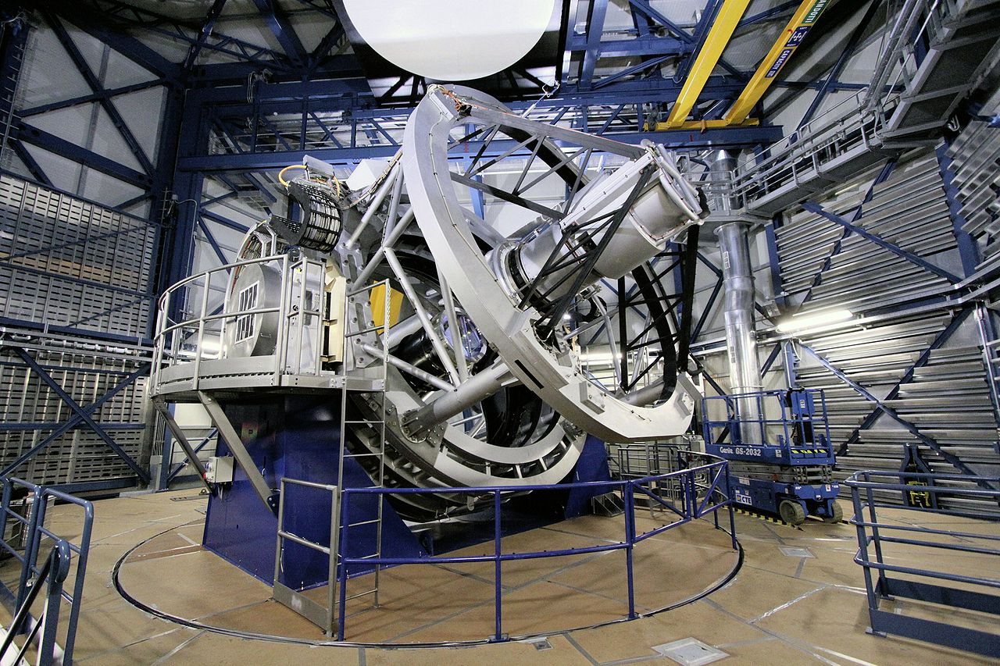

{'<MORE_DETAILED_CAPTION>': 'A large white satellite dish sits on top of a hill. There are trees surrounding the satellite dish. There is a small building next to the dish. '}
Time for caption: 0.29 seconds
{'<OCR>': '-'}
Time for OCR: 0.15 seconds


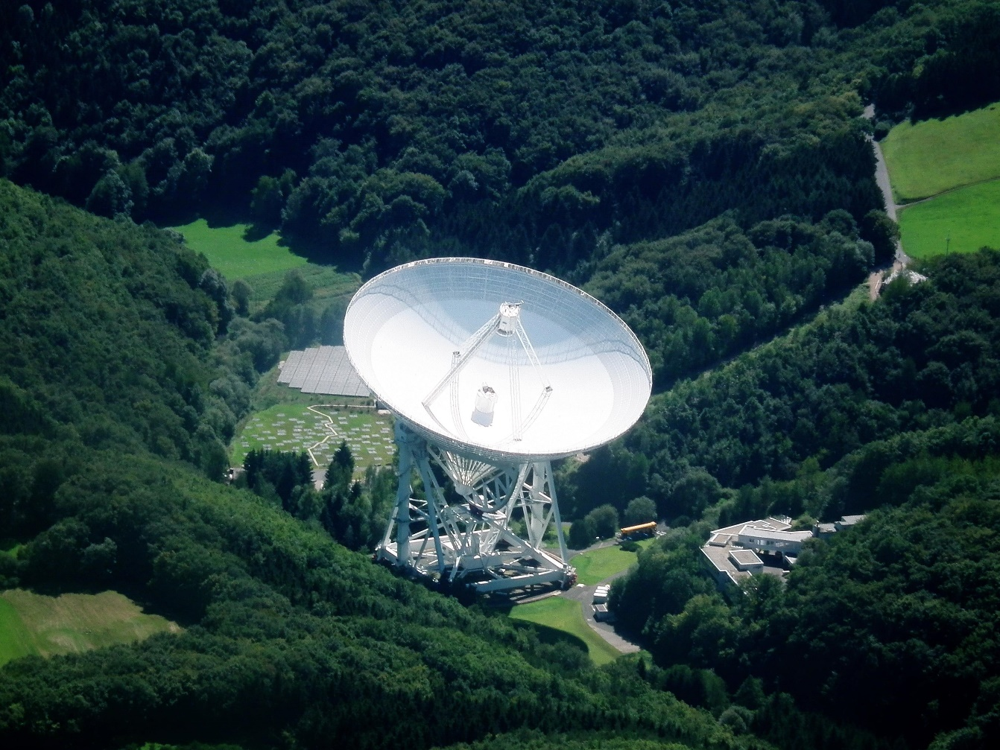

{'<MORE_DETAILED_CAPTION>': 'A bright orange circle is glowing in the dark. The circle has a black hole in the middle of it. The background is completely black.'}
Time for caption: 0.26 seconds
{'<OCR>': 'O'}
Time for OCR: 0.14 seconds


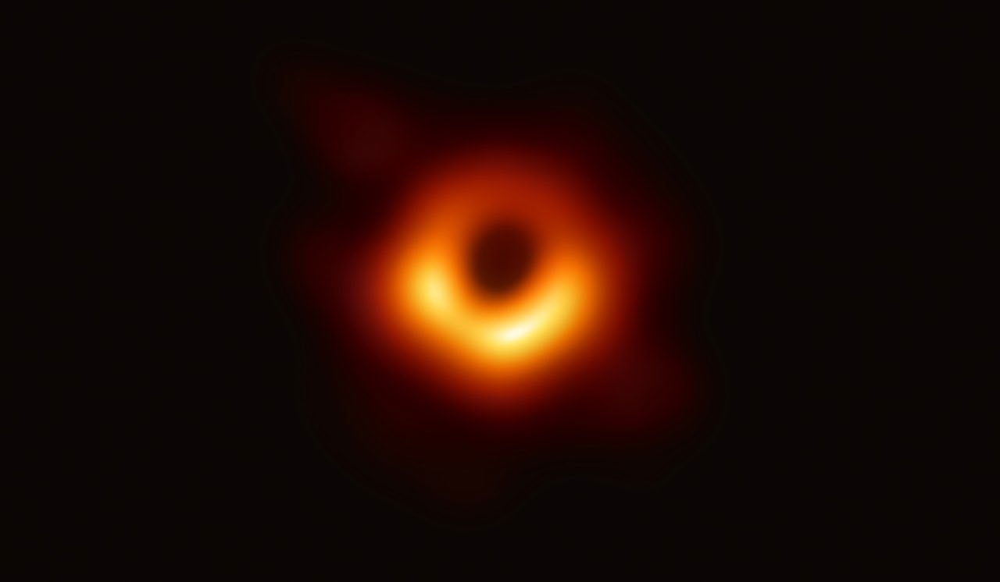

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.43 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'A diagram is showing the relationship between hyperboloide and paraboloide. The diagram is divided into two lines. On the right side, there are two green lines intersecting at the top and on the left side. At the bottom, there is red text that says "Foyers" and "Surfaces réfléchissantes".'}
Time for caption: 0.46 seconds
{'<OCR>': 'HyperboloideParaboloideFoyersSurfaces réfléchissantes'}
Time for OCR: 0.22 seconds


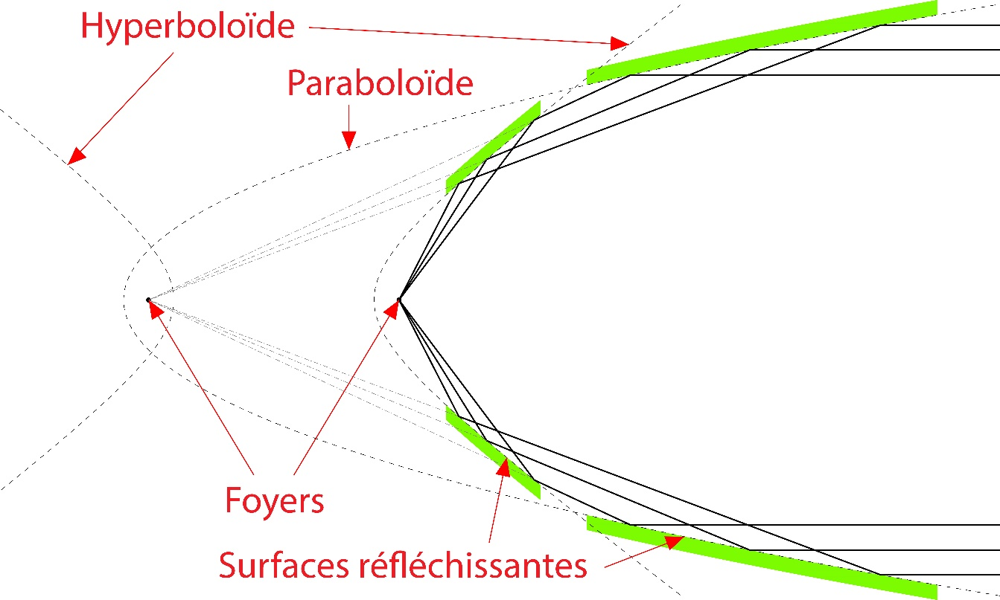

{'<MORE_DETAILED_CAPTION>': 'A large structure is lit up with red lights. There are stairs leading up to the top of the structure. There is a hill behind the structure with trees on it. '}
Time for caption: 0.27 seconds
{'<OCR>': '...'}
Time for OCR: 0.14 seconds


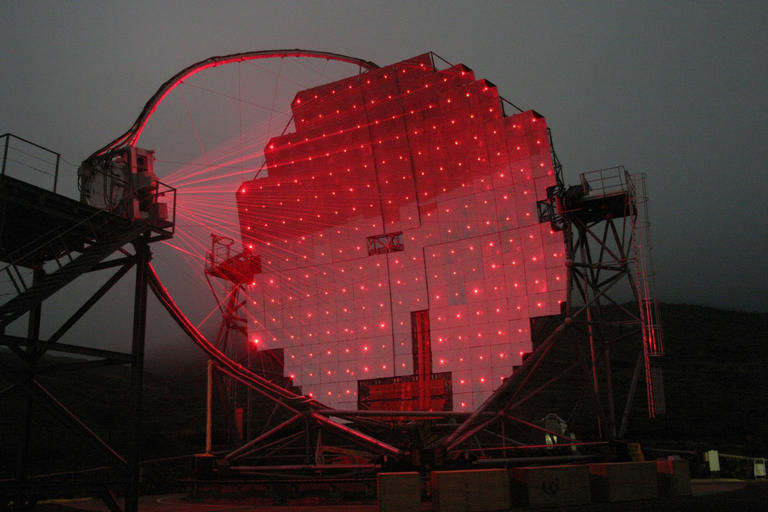

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.43 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'A diagram of a grid is shown. There is a circle in the center of the image that has gray and white squares surrounding it. There are two white circles above the circle. Below the circle is a square with a yellow grid on it. '}
Time for caption: 0.35 seconds
{'<OCR>': 'Source 2Source 1MasqueOmbre portéeDétecteur'}
Time for OCR: 0.20 seconds


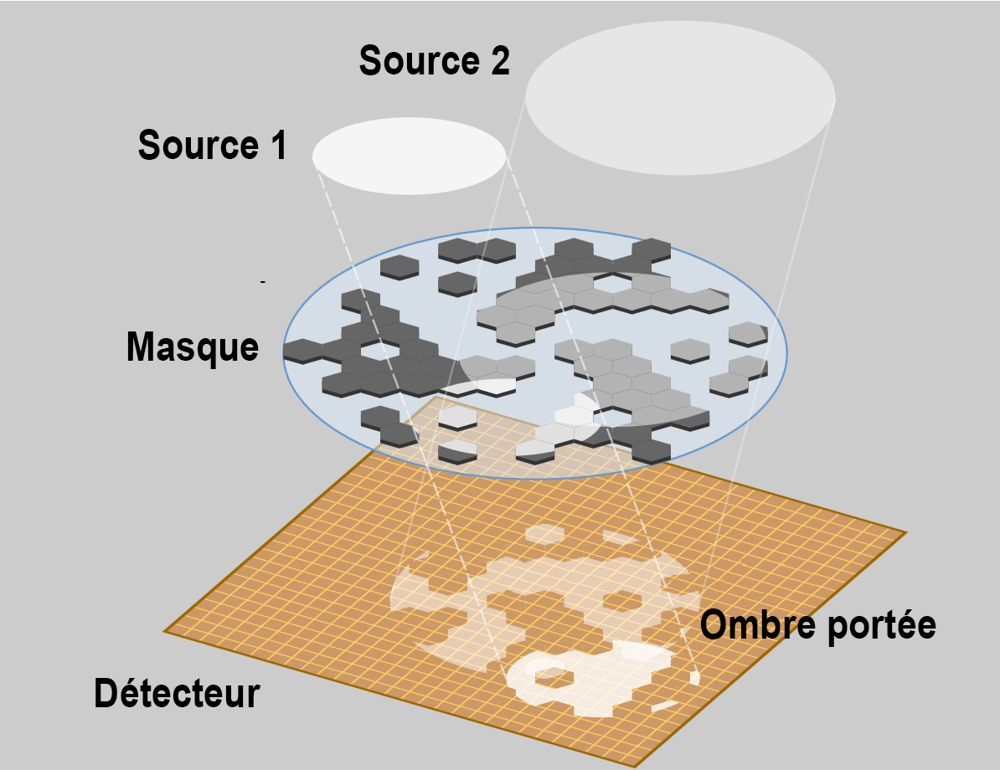

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.44 seconds
{'<OCR>': '4'}
Time for OCR: 0.14 seconds


{'<MORE_DETAILED_CAPTION>': 'The image is a diagram that shows the relationship between two lines. On the left side of the diagram there are two arrows pointing to the left and the right side. The first arrow is pointing at the L and the second arrow points to the right. The lines are labeled with the letters "L1" and "L2" on them.'}
Time for caption: 0.51 seconds
{'<OCR>': "L2++F'O2O2F'2O1"}
Time for OCR: 0.20 seconds


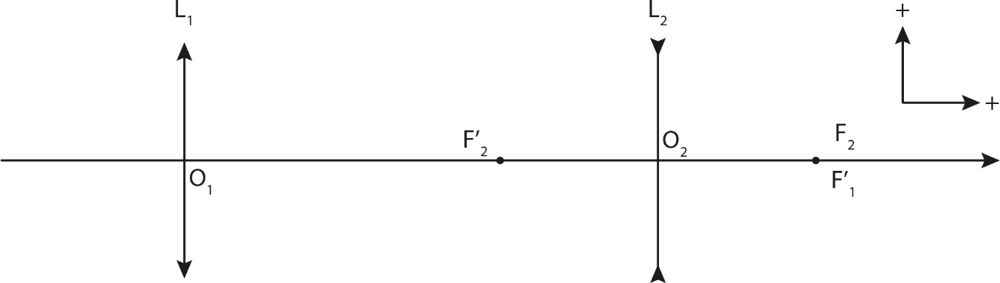

{'<MORE_DETAILED_CAPTION>': 'The image is a diagram that shows the relationship between two lines. On the left side of the diagram there is a straight line that starts at the top and ends at the bottom. There is a red line going through the middle of the two lines and then going to the right side. There are two points on the right and left side that are pointing in the same direction. '}
Time for caption: 0.57 seconds
{'<OCR>': 'L1++F2F2O2O1F1'}
Time for OCR: 0.20 seconds


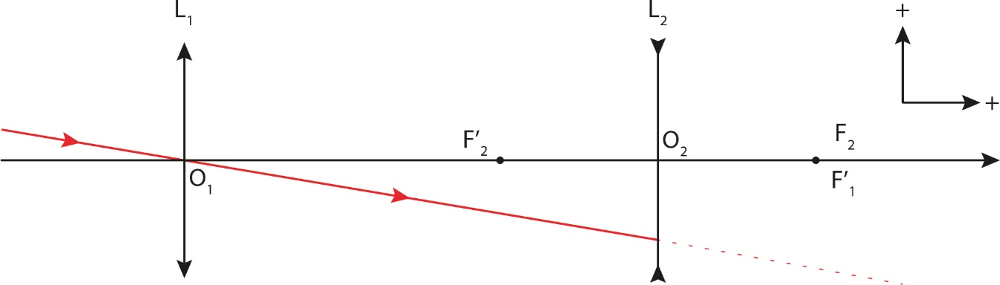

{'<MORE_DETAILED_CAPTION>': 'A, F, and B are two straight lines intersecting at an angle.  There are two points on the left side of the line intersecting with a straight line.  The straight line intersects with a point on the right side.  A, F and F intersect at the ends of the two lines intersect at a point.  F intersects at the end of the straight line and points at the opposite end.  L, L1, L2, L3, L4, L5, L6, L7, L8, L9, L10, L11, L12, L13, L14, L15, L16, L17, L18, L19, L20, L21, L22, L23, L24, L25, L26, L27, L28, L29, L30, L31, L32, L34, L35, L36, L37, L38, L39, L40, L41, L42, L43, L44, L45, L46, L47, L48, L50, L51, L52, L53, L54, L55, L56, L57, L58, L59, L60, L61, L70, L71, L82, L83, L84, L85, L86, L87, L88, L89, L90, L91, L92, L93, L94, L95, L96, L97, L98, L99, L101, L102, L103, L104, L105, L106, L107, L108, L109, L110, L111, L112, L113, L114, L115, L120, L130, L131, L122, L132, L133, L134, L135, L136, L137, L138, L129, L140, L160, L170, L175, L180, L190, L200, L220, L230, L205,

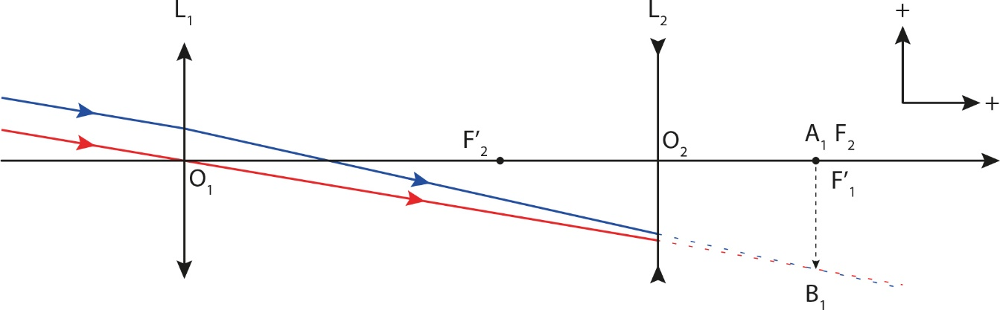

{'<MORE_DETAILED_CAPTION>': 'A, F, and B are two lines intersecting at an angle. A is the direction of the angle, and the F is the angle. There are two points at the ends of the lines intersected at the point A and F. There is also a point at the end of the line A, F and F intersect at the points A and B.'}
Time for caption: 0.53 seconds
{'<OCR>': "L1L2++F'A, F2O2O1F'1B1"}
Time for OCR: 0.23 seconds


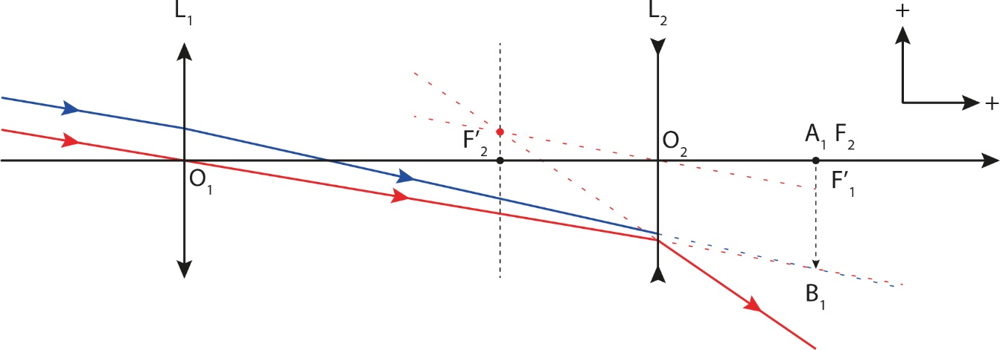

{'<MORE_DETAILED_CAPTION>': 'A, F, and B are two lines intersecting at an angle. A is the direction of the angle, and the F is the angle. There are two straight lines intersected at the point A and F. There is a blue line intersecting the red line, and there are two blue and red lines intersect at the points A and B.'}
Time for caption: 0.48 seconds
{'<OCR>': "L1L2++F'A, F2O2F'1B1"}
Time for OCR: 0.22 seconds


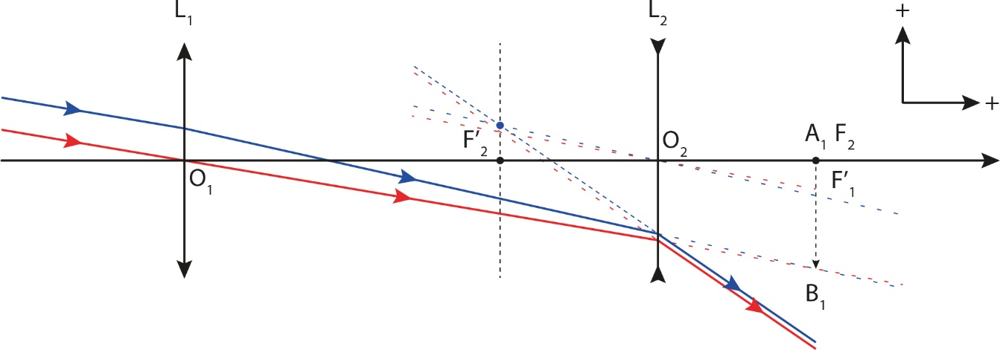

{'<MORE_DETAILED_CAPTION>': 'A is a diagram that shows the relationship between an image and an image.  The image is represented by a straight line.  There are two lines intersecting at the top and bottom of the diagram.  A and F are represented by two points on the x-axis and the y-axis.  F is represented as a point at the end of the line and the other points are represented as an angle.  Both points are pointing in the direction of the image and are labeled as L1, L2, L3, L4, L5, L6, L7, L8, L9, L10, L11, L12, L13, L14, L15, L16, L17, L18, L19, L20, L21, L22, L23, L24, L25, L26, L27, L28, L29, L30, L31, L32, L34, L35, L36, L37, L38, L39, L40, L41, L42, L43, L44, L45, L46, L47, L48, L50, L51, L52, L53, L54, L55, L56, L57, L58, L59, L60, L61, L70, L71, L82, L83, L84, L85, L86, L87, L88, L89, L90, L91, L92, L93, L94, L95, L96, L97, L98, L99, L80, L100, L101, L102, L104, L105, L106, L107, L108, L109, L110, L111, L120, L122, L130, L131, L132, L133, L134, L129, L135, L140, L125, L150, L160

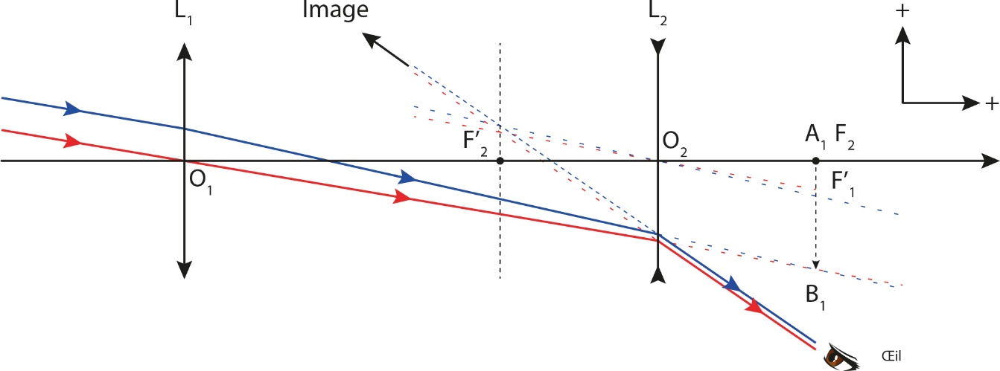

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.44 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'The image is a diagram of a straight line relationship.  There are three straight lines intersecting at the top and bottom of the image.  The first line is labeled "Image" and the second line is labelled "A" and "B".  There is a point labeled "L1" on the top left side of the diagram.  A is labeled as "L2" and there is an arrow pointing to the left side.  F is labelled as "A".  The third line has "A", "F", "a", and "a" on it and there are two points labeled "o", "o" and a "b".  A and "b" are labeled as \'a\' and "f\' are on the right side of this diagram.'}
Time for caption: 0.84 seconds
{'<OCR>': "L1ImageL2++F'A, F,2O2a'a'F'1B1CEil"}
Time for OCR: 0.25 seconds


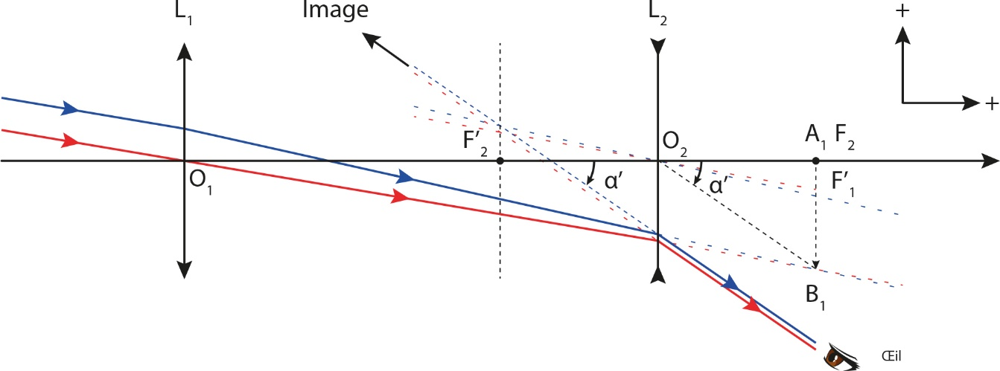

{'<MORE_DETAILED_CAPTION>': 'A is a diagram of a straight line relationship.  There are two straight lines intersecting at the top and bottom of the diagram.  The first line is labeled "Image" and the second line is labelled "A" and "B".  There is a point labeled "L1" on the left side of the image.  An arrow is pointing to the left and the arrow points to the right.  A is labeled as "A1" and a is labelled as "a" and there are two points labeled "a".  A and a are represented as "f" and are represented by blue and red lines.  F is represented as a red line and the other is a blue line.'}
Time for caption: 0.84 seconds
{'<OCR>': "L1ImageL2++F'A, F,2O2aOaF'1B1CEil"}
Time for OCR: 0.26 seconds


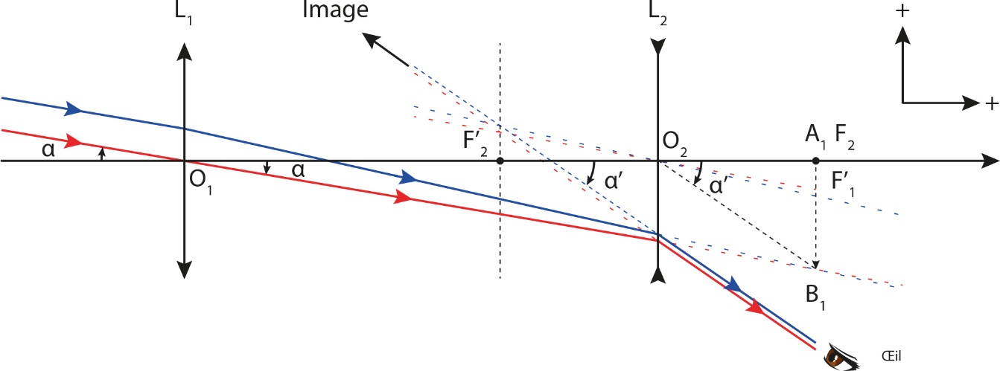

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.44 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'The image is a diagram that shows the relationship between two lines. On the left side of the diagram there are two arrows pointing to the left and right, and on the right side there is a straight line going from L1 to L2. There is also an arrow pointing to L1, L2, L3, L4, L5, L6, L7, L8, L9, L10, L11, L12, L13, L14, L15, L16, L17, L18, L19, L20, L21, L22, L23, L24, L25, L26, L27, L28, L29, L30, L31, L32, L34, L35, L36, L37, L38, L39, L40, L41, L42, L43, L44, L45, L46, L47, L48, L50, L51, L52, L53, L54, L55, L56, L57, L58, L59, L60, L61, L70, L71, L82, L83, L84, L85, L86, L87, L88, L89, L90, L91, L92, L93, L94, L95, L96, L97, L98, L99, L100, L101, L102, L103, L104, L105, L106, L107, L108, L109, L110, L111, L120, L122, L130, L131, L132, L133, L134, L135, L136, L137, L138, L129, L140, L150, L160, L170, L175, L180, L190, L200, L220, L230, L240, L250, L290, L300, L350, L360, L390, L400, L370, L380, L420, L340, L450, L375, L500, L460, L1.'}
Time for caption: 2.4

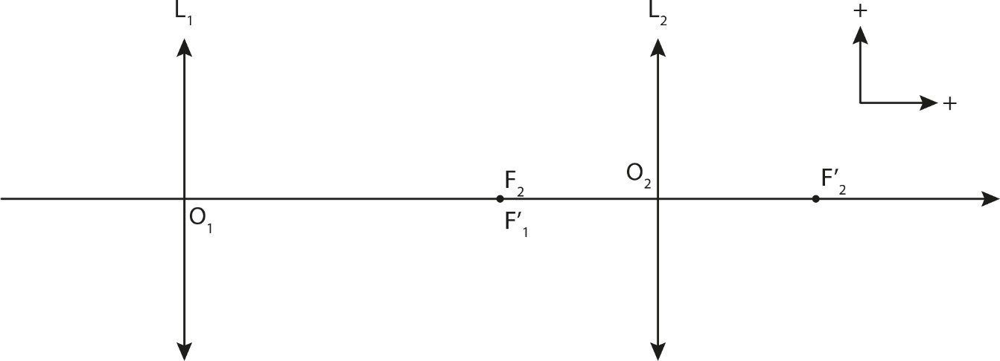

{'<MORE_DETAILED_CAPTION>': 'There are two lines on the white background. On the left side of the lines there is a red line going to the left and the right side is going straight. There are two points on either side of this line. There is also a point on the left that is pointing to the L and a point towards the L on the right.'}
Time for caption: 0.42 seconds
{'<OCR>': "L1++F2O2F2F'2O1F'1"}
Time for OCR: 0.21 seconds


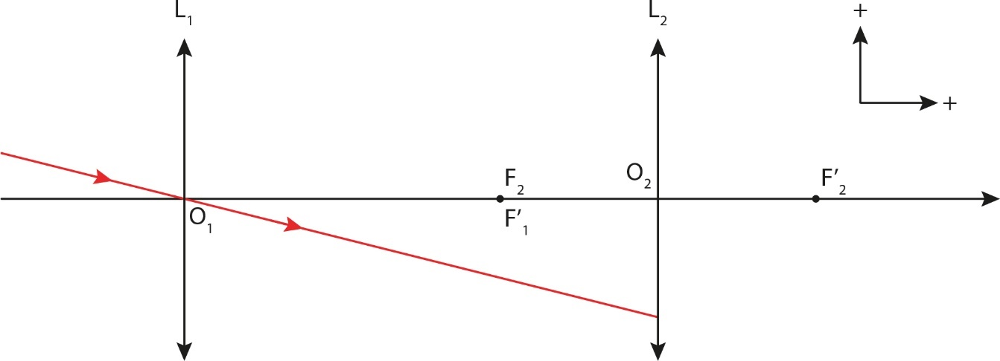

{'<MORE_DETAILED_CAPTION>': 'A, F, and B are two straight lines intersecting at an angle. A is at the top of the line intersecting with a point at the bottom of the x-axis. A and F are at the ends of the two lines intersected at the point of the X-axis, and the point is to the right. There are two arrows pointing to the left and right, and there are two points pointing towards the left. '}
Time for caption: 0.55 seconds
{'<OCR>': "L++A, F2O2F'2O1F'1B1"}
Time for OCR: 0.21 seconds


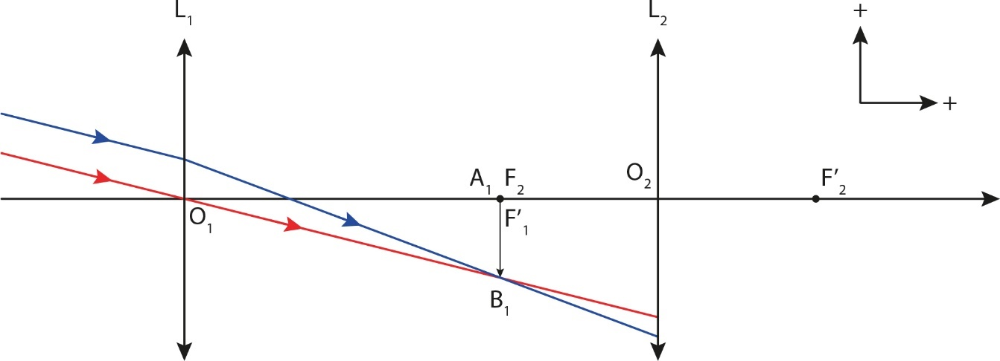

{'<MORE_DETAILED_CAPTION>': 'A, F, and F are two straight lines intersecting at an angle. A is at the top of the line, and L is on the left side. A and F is on a straight line intersected at the bottom. A blue line intersects at the middle of the two lines, and there is a red line intersecting the blue line. There are two arrows pointing to the left and right side of the lines intersected.'}
Time for caption: 0.52 seconds
{'<OCR>': "L1L2+A, F2O2F'2O1F'1B1"}
Time for OCR: 0.22 seconds


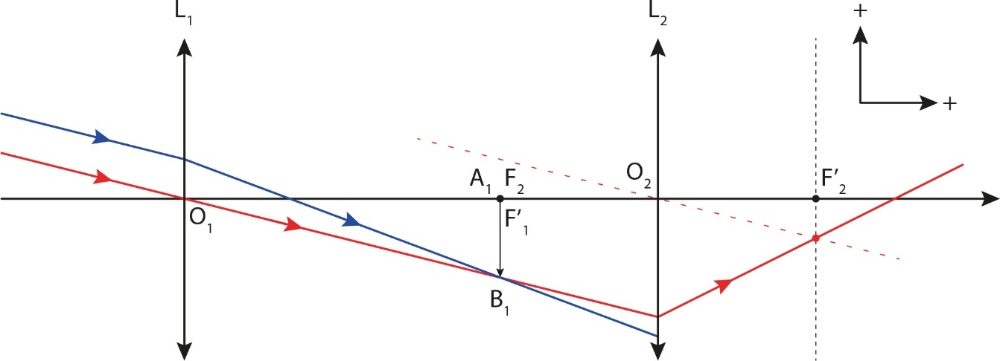

{'<MORE_DETAILED_CAPTION>': 'A, F, and F are two straight lines intersecting at an angle. A is at the top of the line intersecting with a straight line. A and F intersect at the bottom of the straight line intersects at the point A. F intersects with a point B. There is a point L intersecting the straight lines. There are two points L and L intersected at the points L, L1 and L2.'}
Time for caption: 0.51 seconds
{'<OCR>': "L1++A, F2O2F'2O1F'1B1"}
Time for OCR: 0.22 seconds


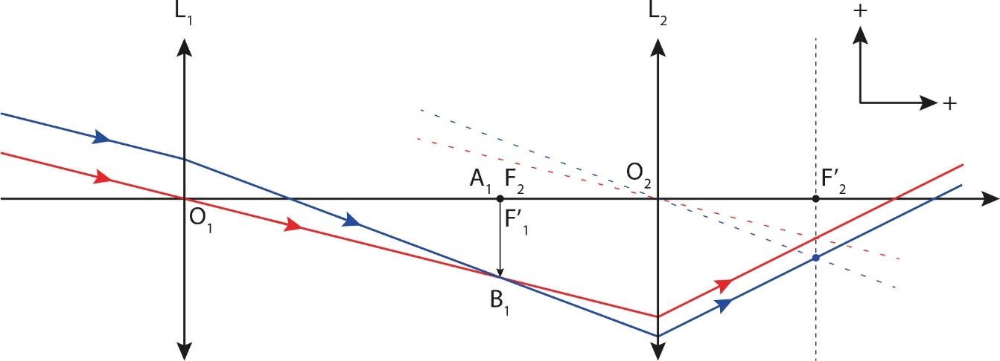

{'<MORE_DETAILED_CAPTION>': 'A, F, and B are two lines intersecting at an angle. There are two points on the opposite side of the two lines. There is an image on the bottom left of the image. '}
Time for caption: 0.33 seconds
{'<OCR>': "L1+L2+CEilA, F2F'2O1F'1B1Image"}
Time for OCR: 0.24 seconds


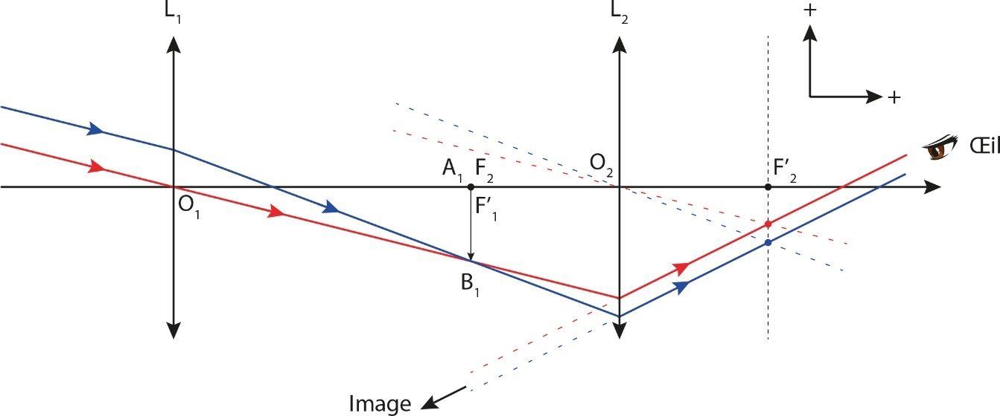

{'<MORE_DETAILED_CAPTION>': 'The image is blurry. There is a cross in the image. The cross is blue in color. There are two black sticks in the cross. The yellow stick is on the left side. The red stick is in the middle. The background is too blurry to make out.'}
Time for caption: 0.45 seconds
{'<OCR>': '4'}
Time for OCR: 0.13 seconds


{'<MORE_DETAILED_CAPTION>': 'A is a diagram that shows the relationship between two straight lines.  There are two lines intersecting at the top and bottom of the diagram.  The first line is labeled "L1" and the second line is labelled "L2".  The third line has "A" and "F" written on it and is labeled as "a".  There is also a "a" and a "f" on the first line.   The second line has a red line and a blue line and there is a "b" written at the bottom of it.'}
Time for caption: 0.75 seconds
{'<OCR>': "L1L2++CEilA, F2a'F'2O1F'a'1B1Image"}
Time for OCR: 0.26 seconds


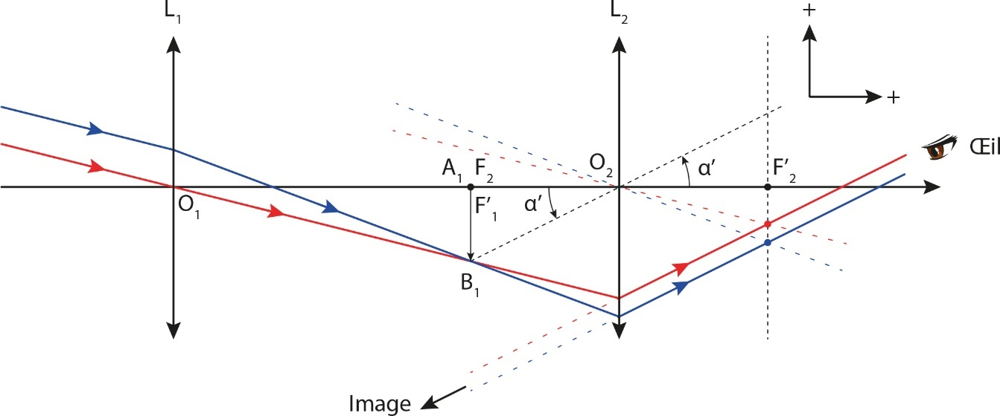

{'<MORE_DETAILED_CAPTION>': 'A is a diagram that shows the relationship between two straight lines.  The straight lines intersects at the top and bottom of the image.  There are two points at the ends of the two lines intersecting at the points A, F, and B.  A is the direction of the light and the light is at the end of the line intersecting.  An arrow is pointing to the left and the arrow points to the right.'}
Time for caption: 0.60 seconds
{'<OCR>': "L1L2++CEilA, F2a'a'F'2aO1aF'1a'1B1Image"}
Time for OCR: 0.29 seconds


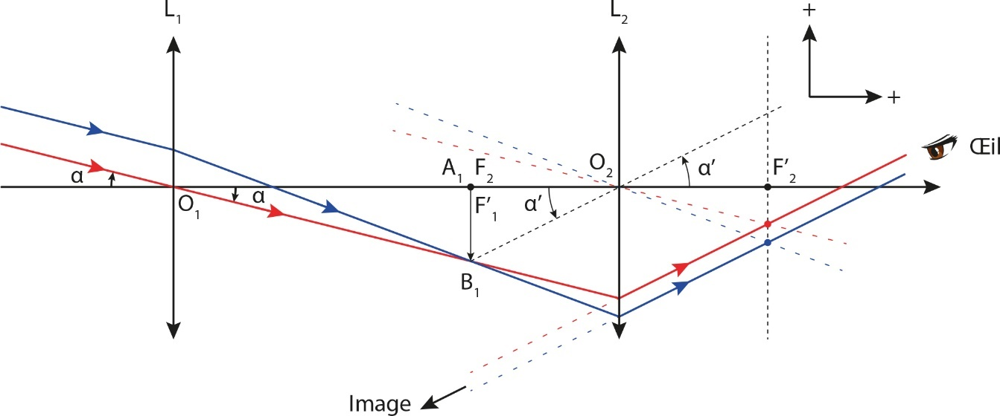

TOTAL TIME: 45.45 seconds


In [8]:
import time
from IPython.display import display, Image

total_start_time = time.time()

for img_base64, image in chunks:
    start_time = time.time()
    caption = run_florence_2(image, "<MORE_DETAILED_CAPTION>", text_input="")
    print(caption)
    print(f"Time for caption: {time.time() - start_time:.2f} seconds")
    
    start_time = time.time()
    ocr = run_florence_2(image, "<OCR>", text_input="")
    print(ocr)
    print(f"Time for OCR: {time.time() - start_time:.2f} seconds")
    
    display(Image(data=base64.b64decode(img_base64), width=400))
print(f"TOTAL TIME: {time.time() - total_start_time:.2f} seconds")
